# Table of Contents
<ul>
    <li><a href="#here">I'm here</a></li>
    <li><a href="#big-intro">1. Introduction and Set-up</a></li>
    <ul>
        <li><a href="#intro">Introduction</a></li>
        <li><a href="#set-up">Setting up the notebook</a></li>
        <li><a href="#load-data">Loading data</a></li>
        <li><a href="#dtypes">Data types</a></li>
    </ul>
    <li><a href="#train-test">Train test split</a></li>
    <ul>
        <li><a href="#intro">Introduction</a></li>
        <li><a href="#set-up">Setting up the notebook</a></li>
        <li><a href="#load-data">Loading data</a></li>
        <li><a href="#dtypes">Data types</a></li>
    </ul>
</ul>

# Setup

In [1]:
import json
from tqdm import tqdm
import numpy as np
import os
import pandas as pd


# import geopandas as gpd
import matplotlib.pyplot as plt 
# import matplotlib.image as img
import seaborn as sns
import cv2
import matplotlib.pyplot as plt


from pathlib import Path

# setup of graphs
sns.set_palette("tab10")
%matplotlib inline

In [2]:
def get_labels(fname):
    """
    Processes a WorldView3 GEOJSON file

    Args:
        fname: filepath to the GeoJson file.

    Outputs:
      Bounding box coordinate array, Chip-name array, and Classes array

    """
    with open(fname) as f:
        data = json.load(f)

    coords = np.zeros((len(data['features']),4))
    chips = np.zeros((len(data['features'])),dtype="object")
    classes = np.zeros((len(data['features'])))

    for i in tqdm(range(len(data['features']))):
        if data['features'][i]['properties']['bounds_imcoords'] != []:
            b_id = data['features'][i]['properties']['image_id']
            val = np.array([int(num) for num in data['features'][i]['properties']['bounds_imcoords'].split(",")])
            chips[i] = b_id
            classes[i] = data['features'][i]['properties']['type_id']
            if val.shape[0] != 4:
                raise ValueError('A bounding box should have 4 entries!')
            else:
                coords[i] = val
        else:
            chips[i] = 'None'

    return coords, chips, classes

# Data import

In [3]:
ORIG_IMGS_PATH = Path("xView/raw_images/all_img")

### Bounding boxes data

In [4]:
datapath = 'xView/'
fname = datapath+"train_labels/xView_train.geojson"
coords, chips, classes = get_labels(fname)
coords, chips, classes

100%|██████████| 601937/601937 [00:02<00:00, 279915.99it/s]


(array([[2712., 1145., 2746., 1177.],
        [2720., 2233., 2760., 2288.],
        [2687., 1338., 2740., 1399.],
        ...,
        [2106.,  361., 2124.,  379.],
        [1917.,   38., 1958.,   64.],
        [2323.,   55., 2349.,   74.]]),
 array(['2355.tif', '2355.tif', '2355.tif', ..., '389.tif', '389.tif',
        '389.tif'], dtype=object),
 array([73., 73., 73., ..., 73., 73., 73.]))

In [5]:
df_coords = pd.DataFrame(coords, columns = ['x0', 'y0', 'x1', 'y1'])
chips = pd.Series(chips, name = 'image_id')
classes = pd.Series(classes, name = 'classes')

In [6]:
df = pd.concat([df_coords, chips, classes], axis=1)
df.head()

,x0,y0,x1,y1,image_id,classes
0,2712.0,1145.0,2746.0,1177.0,2355.tif,73.0
1,2720.0,2233.0,2760.0,2288.0,2355.tif,73.0
2,2687.0,1338.0,2740.0,1399.0,2355.tif,73.0
3,2691.0,1201.0,2730.0,1268.0,2355.tif,73.0
4,2671.0,838.0,2714.0,869.0,2355.tif,73.0


In [7]:
df_orig = df.copy()

### Categories

In [8]:
categories_file = datapath+'xview_class_labels.txt'
labels_list = []
with open(categories_file,'r') as f:    
    labels_list = f.readlines()

labels_list
labels_dict = {}
for label in labels_list:
    label = label.strip('\n')
    label = label.split(':')
    labels_dict[int(label[0])] = label[1]
    
labels_dict
del labels_list

In [9]:
labels_dict

{11: 'Fixed-wing Aircraft',
 12: 'Small Aircraft',
 13: 'Passenger/Cargo Plane',
 15: 'Helicopter',
 17: 'Passenger Vehicle',
 18: 'Small Car',
 19: 'Bus',
 20: 'Pickup Truck',
 21: 'Utility Truck',
 23: 'Truck',
 24: 'Cargo Truck',
 25: 'Truck Tractor w/ Box Trailer',
 26: 'Truck Tractor',
 27: 'Trailer',
 28: 'Truck Tractor w/ Flatbed Trailer',
 29: 'Truck Tractor w/ Liquid Tank',
 32: 'Crane Truck',
 33: 'Railway Vehicle',
 34: 'Passenger Car',
 35: 'Cargo/Container Car',
 36: 'Flat Car',
 37: 'Tank car',
 38: 'Locomotive',
 40: 'Maritime Vessel',
 41: 'Motorboat',
 42: 'Sailboat',
 44: 'Tugboat',
 45: 'Barge',
 47: 'Fishing Vessel',
 49: 'Ferry',
 50: 'Yacht',
 51: 'Container Ship',
 52: 'Oil Tanker',
 53: 'Engineering Vehicle',
 54: 'Tower crane',
 55: 'Container Crane',
 56: 'Reach Stacker',
 57: 'Straddle Carrier',
 59: 'Mobile Crane',
 60: 'Dump Truck',
 61: 'Haul Truck',
 62: 'Scraper/Tractor',
 63: 'Front loader/Bulldozer',
 64: 'Excavator',
 65: 'Cement Mixer',
 66: 'Ground 

In [10]:
len(labels_dict)

60

There are 60 categories provided in the attached text file. We will have to compare those against the categories in the dataframe. 

# Data cleaning / Feature engineering

Let's begin by loading a file with image sizes. This file was obtained by running command `!file` over all images and saving its output. Below we see 10 examples. This method was chosen to avoid loading all images into python, which would take much longer.

Below we see the first 10 lines

In [11]:
!file xView/raw_images/all_img/100.tif

xView/raw_images/all_img/100.tif: TIFF image data, little-endian, direntries=18, height=2714, bps=230, compression=none, PhotometricIntepretation=RGB, width=3379


In [12]:
# for img_full_path in ORIG_IMGS_PATH.glob("*.tif"):
#     !file "{img_full_path}" >> img_data.txt
    
!head -10 img_data.txt

xView/raw_images/all_img/389.tif: TIFF image data, little-endian, direntries=18, height=2601, bps=230, compression=none, PhotometricIntepretation=RGB, width=2589
xView/raw_images/all_img/362.tif: TIFF image data, little-endian, direntries=18, height=3142, bps=230, compression=none, PhotometricIntepretation=RGB, width=3310
xView/raw_images/all_img/1703.tif: TIFF image data, little-endian, direntries=18, height=2626, bps=230, compression=none, PhotometricIntepretation=RGB, width=3175
xView/raw_images/all_img/1695.tif: TIFF image data, little-endian, direntries=18, height=3223, bps=230, compression=none, PhotometricIntepretation=RGB, width=3228
xView/raw_images/all_img/311.tif: TIFF image data, little-endian, direntries=18, height=3064, bps=230, compression=none, PhotometricIntepretation=RGB, width=4763
xView/raw_images/all_img/587.tif: TIFF image data, little-endian, direntries=18, height=3142, bps=230, compression=none, PhotometricIntepretation=RGB, width=3312
xView/raw_images/all_img/1

Let's read the data and extract the information of interest, the width and the height.

In [13]:
with open("img_data.txt") as f:
    img_data = f.readlines()
    
img_data = [img_file.strip(str(ORIG_IMGS_PATH)).strip("\n").split() for img_file in img_data]
img_data

[['389.tif:',
  'TIFF',
  'image',
  'data,',
  'little-endian,',
  'direntries=18,',
  'height=2601,',
  'bps=230,',
  'compression=none,',
  'PhotometricIntepretation=RGB,',
  'width=2589'],
 ['362.tif:',
  'TIFF',
  'image',
  'data,',
  'little-endian,',
  'direntries=18,',
  'height=3142,',
  'bps=230,',
  'compression=none,',
  'PhotometricIntepretation=RGB,',
  'width=3310'],
 ['1703.tif:',
  'TIFF',
  'image',
  'data,',
  'little-endian,',
  'direntries=18,',
  'height=2626,',
  'bps=230,',
  'compression=none,',
  'PhotometricIntepretation=RGB,',
  'width=3175'],
 ['1695.tif:',
  'TIFF',
  'image',
  'data,',
  'little-endian,',
  'direntries=18,',
  'height=3223,',
  'bps=230,',
  'compression=none,',
  'PhotometricIntepretation=RGB,',
  'width=3228'],
 ['311.tif:',
  'TIFF',
  'image',
  'data,',
  'little-endian,',
  'direntries=18,',
  'height=3064,',
  'bps=230,',
  'compression=none,',
  'PhotometricIntepretation=RGB,',
  'width=4763'],
 ['587.tif:',
  'TIFF',
  'image'

In [14]:
# keep only the entries containing either .tif height or width
clean_img_data = []
words_of_interest = [".tif", "width", "height"]
for img_file in img_data:
    clean_items = {}
    for item in img_file:        
#         if any(word in item for word in words_of_interest): clean_items.append(item)    
        if ".tif:" in item: clean_items["image_id"] = item.strip(":")
        elif "width" in item: clean_items["width"] = int(item.strip("width="))
        elif "height" in item: clean_items["height"] = int(item.strip("height=").strip(","))
    clean_img_data.append(clean_items)
clean_img_data

[{'image_id': '389.tif', 'height': 2601, 'width': 2589},
 {'image_id': '362.tif', 'height': 3142, 'width': 3310},
 {'image_id': '1703.tif', 'height': 2626, 'width': 3175},
 {'image_id': '1695.tif', 'height': 3223, 'width': 3228},
 {'image_id': '311.tif', 'height': 3064, 'width': 4763},
 {'image_id': '587.tif', 'height': 3142, 'width': 3312},
 {'image_id': '1169.tif', 'height': 2891, 'width': 2893},
 {'image_id': '291.tif', 'height': 3065, 'width': 4764},
 {'image_id': '2193.tif', 'height': 2653, 'width': 2715},
 {'image_id': '310.tif', 'height': 3064, 'width': 4764},
 {'image_id': '140.tif', 'height': 3324, 'width': 4193},
 {'image_id': '1436.tif', 'height': 3057, 'width': 3294},
 {'image_id': '488.tif', 'height': 2769, 'width': 2978},
 {'image_id': '2114.tif', 'height': 2992, 'width': 3134},
 {'image_id': '1824.tif', 'height': 2908, 'width': 2941},
 {'image_id': '836.tif', 'height': 2770, 'width': 2975},
 {'image_id': '193.tif', 'height': 3325, 'width': 4197},
 {'image_id': '2550.tif'

In [15]:
img_sizes_df = pd.DataFrame(clean_img_data)
del clean_img_data, img_data

In [16]:
len(df)

601937

In [17]:
df = df.merge(img_sizes_df, on= 'image_id', how="outer")
df.head()

,x0,y0,x1,y1,image_id,classes,height,width
0,2712.0,1145.0,2746.0,1177.0,2355.tif,73.0,2667.0,2739.0
1,2720.0,2233.0,2760.0,2288.0,2355.tif,73.0,2667.0,2739.0
2,2687.0,1338.0,2740.0,1399.0,2355.tif,73.0,2667.0,2739.0
3,2691.0,1201.0,2730.0,1268.0,2355.tif,73.0,2667.0,2739.0
4,2671.0,838.0,2714.0,869.0,2355.tif,73.0,2667.0,2739.0


In [18]:
len(df)

601937

In [19]:
# lets check if the sizes agree with reading the image

img_idx = 2355
img_path = ORIG_IMGS_PATH /(str(img_idx)+'.tif')
img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
print(img.shape)
del img

(2667, 2739, 3)


#### Nan values

In [20]:
df.isna().sum()

x0            0
y0            0
x1            0
y1            0
image_id      0
classes       0
height      131
width       131
dtype: int64

The two columns we just added contain  NaN values. This is likely produced because some image has not been found and thus its width and height could not be extracted. Let's check that

In [21]:
df_na = df[df.isna().any(axis=1)]
df_na.head()

,x0,y0,x1,y1,image_id,classes,height,width
421978,3239.0,340.0,3275.0,377.0,1395.tif,73.0,NaN,NaN
421979,3187.0,-77.0,3312.0,1.0,1395.tif,73.0,NaN,NaN
421980,3217.0,99.0,3271.0,141.0,1395.tif,73.0,NaN,NaN
421981,3218.0,175.0,3255.0,209.0,1395.tif,73.0,NaN,NaN
421982,3222.0,45.0,3263.0,71.0,1395.tif,73.0,NaN,NaN


In [22]:
df_na.image_id.unique()

array(['1395.tif'], dtype=object)

The image is not available. The rows are removed then

In [23]:
df = df.dropna()

In [24]:
df.isna().sum()

x0          0
y0          0
x1          0
y1          0
image_id    0
classes     0
height      0
width       0
dtype: int64

## Data types

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 601806 entries, 0 to 601936
Data columns (total 8 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   x0        601806 non-null  float64
 1   y0        601806 non-null  float64
 2   x1        601806 non-null  float64
 3   y1        601806 non-null  float64
 4   image_id  601806 non-null  object 
 5   classes   601806 non-null  float64
 6   height    601806 non-null  float64
 7   width     601806 non-null  float64
dtypes: float64(7), object(1)
memory usage: 41.3+ MB


Bounding boxes coordinates, classes, height and width should all be integers. Let's check if all data has no decimals. First we obtain the decimal part of the numbers. 

In [26]:
int_columns = ['x0','y0','x1','y1', 'classes', 'height', 'width']
df_decimals = df[int_columns] %1
df_decimals.head()

,x0,y0,x1,y1,classes,height,width
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We calculate the sum over a column

In [27]:
df_decimals.sum(axis=0)

x0         0.0
y0         0.0
x1         0.0
y1         0.0
classes    0.0
height     0.0
width      0.0
dtype: float64

All sums are 0, meaning no number should contain a decimal part. We can safely convert those numbers to integers.

In [28]:
df[['x0','y0','x1','y1', 'classes', 'height', 'width']] = df[['x0','y0','x1','y1', 'classes', 'height', 'width']]\
                                                            .round().astype(int)
df.head()

,x0,y0,x1,y1,image_id,classes,height,width
0,2712,1145,2746,1177,2355.tif,73,2667,2739
1,2720,2233,2760,2288,2355.tif,73,2667,2739
2,2687,1338,2740,1399,2355.tif,73,2667,2739
3,2691,1201,2730,1268,2355.tif,73,2667,2739
4,2671,838,2714,869,2355.tif,73,2667,2739



### Evaluation of the classes

We will look now at the classes attributed to the bounding boxes

In [29]:
class_idx_from_file = set(labels_dict.keys())

In [30]:
df.classes.value_counts()

73    316672
18    211660
23     12189
19      6975
24      5899
       ...  
56        70
57        64
75        51
82        28
33        17
Name: classes, Length: 62, dtype: int64

There are 62 classes. According to Lam *et al.* there should only be 60 classes on the dataset. We compare now the classes attributed to the bounding boxes to the file containing the class index to class name mapping.

In [31]:
classes_idx = set(df.classes.value_counts().index)

In [32]:
print(class_idx_from_file.difference(classes_idx))
print(classes_idx.difference(class_idx_from_file))

set()
{82, 75}


Some bounding boxes have a class index which has no correspondance in the label mapping file: **82 and 75**

Let's have a look at those two classes

In [33]:
invalid_index = df[df.classes.isin([75, 82])].index

In [34]:
print(f"Number of unnassigned labels is {len(invalid_index)}"+\
      f" which represents {len(invalid_index)/len(df)*100:.2f}% of the total of bboxes")

Number of unnassigned labels is 79 which represents 0.01% of the total of bboxes


Since the number of not mapped bounding boxes is too low, it has been decided to drop those labels.

In [35]:
df = df.drop(labels = invalid_index, axis = 0)

Another thing to note is that some objects are attributed a parent class index, instead of a child class index. This is not an issue with the data, it was done on purpose by the creators of the dataset. According to the Lam *et al.* (2018) this is due to the way the annotations are done, when the labeler is unable to make a confident determination from the child classes, the object will fall back to the more general parent category. 

### Is data valid?

We are going to check now if the bounding boxes  coordinates are valid. The following issues are identified related to that:
- The bounding box might have its coordinates upside down. The bounding box are defined by providing two of their opposite corners: the upper right corner is provided as point 0 and the bottom left corner is the point 1. So point 1 should always have strictly larger coordinates values than point 0.
- A bounding box could be completely out of the image.
- Bounding boxes could be partially outside of the image.

#### 1. Relative corners positions

We start checking if the point 1 coordinates are always strictly larger than point 0 coordinates.

In [36]:
mask_inverted = (df.x0>=df.x1) | (df.y0>=df.y1) 
sum(mask_inverted)

9

There are 9 points for which the condition is not fulfilled.

In [37]:
df[mask_inverted]

,x0,y0,x1,y1,image_id,classes,height,width
36653,1882,2478,1883,2478,118.tif,73,2726,2872
108017,566,764,567,764,2532.tif,24,2428,2912
301988,2205,1663,2205,1663,1121.tif,73,3020,3923
321643,97,2313,97,2313,2230.tif,18,2640,3439
360543,2501,2372,2501,2373,1205.tif,24,2892,2892
463231,2930,2683,2930,2683,24.tif,18,2932,3094
474410,2391,1856,2391,1858,2197.tif,73,2652,2716
527056,3043,358,3044,358,1530.tif,73,3219,3237
529238,33,1327,33,1328,1530.tif,73,3219,3237


We see that what happens is that some bounding boxes have actually one of their sides or both of size 0 pixel. We remove those rows.

In [38]:
len(df)

601727

In [39]:
df = df.drop(df[mask_inverted].index, axis = 0)
len(df)

601718

#### Small sides

In [40]:
df['x'] = df.x1-df.x0
df['y'] = df.y1-df.y0

In [41]:
df.head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y
0,2712,1145,2746,1177,2355.tif,73,2667,2739,34,32
1,2720,2233,2760,2288,2355.tif,73,2667,2739,40,55
2,2687,1338,2740,1399,2355.tif,73,2667,2739,53,61
3,2691,1201,2730,1268,2355.tif,73,2667,2739,39,67
4,2671,838,2714,869,2355.tif,73,2667,2739,43,31


In [42]:
mask_small = (df.x <=5) | (df.y <=5)
np.sum(mask_small)

6008

In [43]:
df[mask_small]

,x0,y0,x1,y1,image_id,classes,height,width,x,y
71,1898,146,1909,151,2355.tif,18,2667,2739,11,5
110,991,1533,1004,1538,2355.tif,18,2667,2739,13,5
124,1377,414,1382,428,2355.tif,18,2667,2739,5,14
126,1384,442,1389,456,2355.tif,18,2667,2739,5,14
129,1361,439,1365,451,2355.tif,18,2667,2739,4,12
...,...,...,...,...,...,...,...,...,...,...
599039,179,2108,189,2112,144.tif,18,2606,3094,10,4
599280,1183,894,1194,899,331.tif,18,2601,2589,11,5
599761,891,384,896,394,345.tif,18,2601,2589,5,10
599914,2024,326,2032,331,345.tif,19,2601,2589,8,5


#### 2. Bounding boxes completely outside the image

Now that we have the sizes let's first check if there are boxes that are completely out of the image

In [44]:
mask_box_completely_out = ((df.x1<=0)) | ((df.y1<=0)) |\
    (df.x0>=df.width) | (df.y0>=df.height)  
sum(mask_box_completely_out)

23

In [45]:
df[mask_box_completely_out]

,x0,y0,x1,y1,image_id,classes,height,width,x,y
34012,-20,1518,0,1544,118.tif,73,2726,2872,20,26
121688,455,-94,514,0,1450.tif,73,3148,3912,59,94
124237,601,-417,1088,0,1459.tif,73,3148,3913,487,417
135211,2867,-150,3035,0,609.tif,73,2769,2976,168,150
135544,-48,1753,0,1813,610.tif,73,2769,2976,48,60
135889,2531,-39,2572,0,613.tif,73,2769,2977,41,39
149516,1218,-48,1256,0,2031.tif,73,2951,3098,38,48
149522,1559,-46,1604,0,2031.tif,73,2951,3098,45,46
160747,-79,990,0,1063,1042.tif,79,3216,3194,79,73
169436,-86,2,0,49,362.tif,73,3142,3310,86,47


In [46]:
df = df.drop(df[mask_box_completely_out].index, axis = 0)
del mask_box_completely_out
len(df)

601695

#### 3. Bounding boxes partially out

Now let's check if some bounding boxes are partially out

In [47]:
mask_box_partially_out = ((df.x0<=0)) | ((df.y0<=0)) |\
    (df.x1>=df.width) | (df.y1>=df.height)  
sum(mask_box_partially_out)

10623

In [48]:
df[mask_box_partially_out].head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y
0,2712,1145,2746,1177,2355.tif,73,2667,2739,34,32
1,2720,2233,2760,2288,2355.tif,73,2667,2739,40,55
2,2687,1338,2740,1399,2355.tif,73,2667,2739,53,61
6,2709,1014,2747,1072,2355.tif,73,2667,2739,38,58
9,2704,2123,2749,2151,2355.tif,73,2667,2739,45,28


The fact that a bounding box is partially out does not imply necessarily that it is incorrect. The tif image files of the dataset come from larger images, which themselves were the ones used to label the images. So a bounding box that is partially out could be simply a bounding box that falls in two different images and for which the coordinates have not been set to fit in the image size.

We can have a look at some of this bounding boxes to decide if the data is valid or not

Function to plot a bounding box:

In [49]:
def plot_bbox(img_idx, bbox, img=None, margin = 0.05, ax = None):
    """Function that plots a bounding box from a image. Inputs:
    - img_idx: index of the image from which the bounding box has to be plotted.
    - bbox: np.array containing the coordinates of the two corner points as [x0 y0 x1 y1]
    - margin: if the image shown has to be extended beyond the image coordinates by a certain
             percentage of the image size"""
    if not ax:
        ax = plt.gca()
    
    # load img if not provided
    if img is None:
        if isinstance(img_idx, str):
            idx_extension = img_idx.find(".")
            base_id = img_idx[:idx_extension]
        elif isinstance(img_idx, int):
            base_id = str(img_idx)
        else:
            raise TypeError("Only input formats accepted are str and int")

    #     ax.set_aspect("equal", adjustable="datalim")    
        img_path = ORIG_IMGS_PATH /(str(base_id)+'.tif')
        img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
    
    
    width = (bbox[2]-bbox[0])
    height = (bbox[3]-bbox[1])
    
    # enlarge the coordinages
    bbox[0], bbox[2] = int(bbox[0]-round(width/2*margin)), int(bbox[2]+round(width/2*margin))
    bbox[1], bbox[3] = int(bbox[1]-round(height/2*margin)), int(bbox[3]+round(height/2*margin))
    
    # cut the coordinates to fit in the image
    bbox[:2] = np.maximum(bbox[:2], [0,0])
    bbox[2:] = np.minimum(bbox[2:], img.shape[1::-1])
    img = img[bbox[1]:bbox[3],bbox[0]:bbox[2]]    
    ax.imshow(img);    
    ax.grid(False)

In [50]:
df.head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y
0,2712,1145,2746,1177,2355.tif,73,2667,2739,34,32
1,2720,2233,2760,2288,2355.tif,73,2667,2739,40,55
2,2687,1338,2740,1399,2355.tif,73,2667,2739,53,61
3,2691,1201,2730,1268,2355.tif,73,2667,2739,39,67
4,2671,838,2714,869,2355.tif,73,2667,2739,43,31


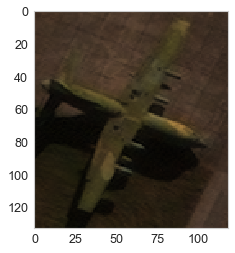

In [51]:
class_filter = 11
df_class = df[df.classes== class_filter].sample(1)

plot_bbox(df_class['image_id'].values[0], df_class.iloc[0,:4].values)

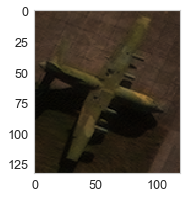

In [52]:
fig , ax = plt.subplots(figsize = [3,3])
plot_bbox(df_class['image_id'].values[0], df_class.iloc[0,:4].values, ax = ax)

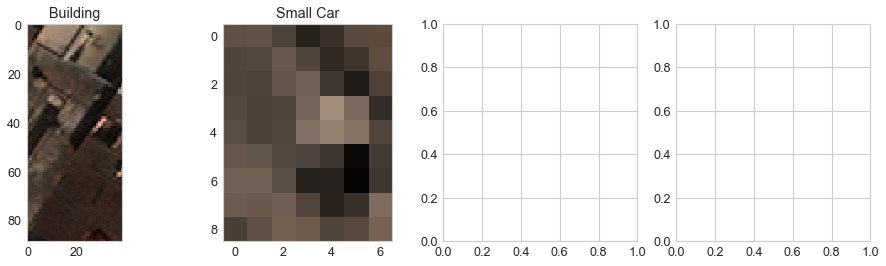

In [53]:
n_samples = 2
ncols = 4
nrows = np.ceil(n_samples/ncols).astype(int)

fig , ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = [4*ncols, 4*nrows])
ax = ax.ravel()
df_bboxes = df[mask_box_partially_out].sample(n_samples)
for count, (index, row) in enumerate(df_bboxes.iterrows()):
#     print(row)
    plot_bbox(row['image_id'], row[:4], ax = ax[count])
    ax[count].set_title(labels_dict[row['classes']])
    

It seems the bounding boxes are coherent with what they are supposed to be and do not seem associated to a wrong annotation.

It has been decided to keep them. The coordinates need to be corrected then


In [54]:
condition_list = [(df.x0<=0), ((df.y0<=0)), (df.x1>=df.width) , (df.y1>=df.height)]
choice_list = [0, 0, df.width, df.height]
col_name = ['x0', 'y0', 'x1', 'y1']
df_test = df[col_name].copy()
for i, col in enumerate(col_name):
    df_test[col] = np.where(condition_list[i], choice_list[i], df_test[col])   


In [55]:
df_test[mask_box_partially_out].iloc[[0,100,1000,1752,5789,10203],:]

,x0,y0,x1,y1
0,2712,1145,2739,1177
5550,1460,2576,1604,2668
71377,1792,3127,1954,3217
123584,2168,3133,2199,3148
322029,2571,1144,2576,1183
570643,1079,2740,1192,2820


In [56]:
df[mask_box_partially_out].iloc[[0,100,1000,1752,5789,10203],:]

,x0,y0,x1,y1,image_id,classes,height,width,x,y
0,2712,1145,2746,1177,2355.tif,73,2667,2739,34,32
5550,1460,2576,1604,2743,2370.tif,77,2668,2739,144,167
71377,1792,3127,1954,3268,870.tif,73,3217,3291,162,141
123584,2168,3133,2199,3160,1452.tif,86,3148,3913,31,27
322029,2571,1144,2616,1183,1788.tif,73,2564,2576,45,39
570643,1079,2740,1192,2821,40.tif,73,2820,2945,113,81


In [57]:
df_test[df_test.x0<0]

,x0,y0,x1,y1


In [58]:
df[col_name] = df_test[col_name]
df[mask_box_partially_out].head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y
0,2712,1145,2739,1177,2355.tif,73,2667,2739,34,32
1,2720,2233,2739,2288,2355.tif,73,2667,2739,40,55
2,2687,1338,2739,1399,2355.tif,73,2667,2739,53,61
6,2709,1014,2739,1072,2355.tif,73,2667,2739,38,58
9,2704,2123,2739,2151,2355.tif,73,2667,2739,45,28


In [59]:
del df_test

## Data transformations / augmentations / Feature engineering

We are going to add a new column containing the parent class of the bounding box, so it can be used in data exploration.

The parent categories for each of the child classes is below, as provided in Lam *et al.* 2018.

In [60]:
parent_child_map = {
    11: [12, 13,],
    17: [18, 19],
    23: [20, 21, 24,25,26,27,28,29,],
    33:[34,35,36,37,38,],
    40 :[41,42,44,45,47,49,50,51,52,],
    53:[ 32, 54, 55, 56, 57, 59, 60, 61, 62, 63, 64, 65 ,66,],
    73: [71, 72, 74, 76, 77,],
    -1:[15,79, 83, 84, 86, 89, 91, 93, 94],
}
parent_child_map

{11: [12, 13],
 17: [18, 19],
 23: [20, 21, 24, 25, 26, 27, 28, 29],
 33: [34, 35, 36, 37, 38],
 40: [41, 42, 44, 45, 47, 49, 50, 51, 52],
 53: [32, 54, 55, 56, 57, 59, 60, 61, 62, 63, 64, 65, 66],
 73: [71, 72, 74, 76, 77],
 -1: [15, 79, 83, 84, 86, 89, 91, 93, 94]}

-1 category corresponds to objects assigned to the None category. It is not a category that regroups objects which are somehow similar, it is for objects that had no other convenient parent category.

In [61]:
child_parent_map = {}
for parent in parent_child_map.keys():
    for child in parent_child_map[parent]:
        child_parent_map[child] = parent
    child_parent_map[parent] = parent

child_parent_map

{12: 11,
 13: 11,
 11: 11,
 18: 17,
 19: 17,
 17: 17,
 20: 23,
 21: 23,
 24: 23,
 25: 23,
 26: 23,
 27: 23,
 28: 23,
 29: 23,
 23: 23,
 34: 33,
 35: 33,
 36: 33,
 37: 33,
 38: 33,
 33: 33,
 41: 40,
 42: 40,
 44: 40,
 45: 40,
 47: 40,
 49: 40,
 50: 40,
 51: 40,
 52: 40,
 40: 40,
 32: 53,
 54: 53,
 55: 53,
 56: 53,
 57: 53,
 59: 53,
 60: 53,
 61: 53,
 62: 53,
 63: 53,
 64: 53,
 65: 53,
 66: 53,
 53: 53,
 71: 73,
 72: 73,
 74: 73,
 76: 73,
 77: 73,
 73: 73,
 15: -1,
 79: -1,
 83: -1,
 84: -1,
 86: -1,
 89: -1,
 91: -1,
 93: -1,
 94: -1,
 -1: -1}

In [62]:
parent_keys = [11, 17, 23, 33, 40, 53, 73]
parent_dict = {}
for k in parent_keys:    
    parent_dict[k] = labels_dict[k]
    
parent_dict[-1] = "None"
parent_dict

{11: 'Fixed-wing Aircraft',
 17: 'Passenger Vehicle',
 23: 'Truck',
 33: 'Railway Vehicle',
 40: 'Maritime Vessel',
 53: 'Engineering Vehicle',
 73: 'Building',
 -1: 'None'}

We can also create an alternative parent class distribution, by keeping all child classes that are in the None category. The problem with **None** parent class is that objects are typically completely different from one another (for example helicopter and vehicle lot) and thus an algorithm would struggle to find patterns to correctly predict this class.

In [63]:
child_parent_alt_map = {}
for parent in parent_child_map.keys():
    if parent !=-1:
        for child in parent_child_map[parent]:
            child_parent_alt_map[child] = parent
        child_parent_alt_map[parent] = parent
    else:
        for child in parent_child_map[parent]:
            child_parent_alt_map[child] = child        

In [64]:
parent_alt_keys = parent_keys.copy()
parent_alt_keys.extend(parent_child_map[-1])
parent_alt_dict = {}

for k in parent_alt_keys:    
    parent_alt_dict[k] = labels_dict[k]

We add a parent class on the dataframe to ease the exploratory data analysis later on.

In [65]:
df['parent'] = df.classes.apply(lambda x:child_parent_map[x])
df['parent_alt'] = df.classes.apply(lambda x:child_parent_alt_map[x])

For the object detection model we need labels to go from 0 to the number of classes -1, and with all numbers in between assigned to a label. These label type is created below, and its mapping

In [66]:
# yolo - labels : need to go from 0 to len(labels)-1, ordered
labels_to_yolo_map = {}
yolo_to_labels_map = {}
for key, value in zip(range(len(labels_dict)), labels_dict.keys()):
    labels_to_yolo_map[key] = value
    yolo_to_labels_map[value] = key
    
labels_to_yolo_map

{0: 11,
 1: 12,
 2: 13,
 3: 15,
 4: 17,
 5: 18,
 6: 19,
 7: 20,
 8: 21,
 9: 23,
 10: 24,
 11: 25,
 12: 26,
 13: 27,
 14: 28,
 15: 29,
 16: 32,
 17: 33,
 18: 34,
 19: 35,
 20: 36,
 21: 37,
 22: 38,
 23: 40,
 24: 41,
 25: 42,
 26: 44,
 27: 45,
 28: 47,
 29: 49,
 30: 50,
 31: 51,
 32: 52,
 33: 53,
 34: 54,
 35: 55,
 36: 56,
 37: 57,
 38: 59,
 39: 60,
 40: 61,
 41: 62,
 42: 63,
 43: 64,
 44: 65,
 45: 66,
 46: 71,
 47: 72,
 48: 73,
 49: 74,
 50: 76,
 51: 77,
 52: 79,
 53: 83,
 54: 84,
 55: 86,
 56: 89,
 57: 91,
 58: 93,
 59: 94}

<a id='EDA'></a>
# Exploration of the data

In [67]:
import cv2
import matplotlib.pyplot as plt

def plot_img_w_bbox(df, img_idx, n_box = None):
    df_img = df[df.image_id==str(img_idx)+'.tif']
    img_path = ORIG_IMGS_PATH /(str(img_idx)+'.tif')
    img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)

    if n_box is None: n_box = 50  
    if n_box == "max" : n_box = df_img.shape[0]
    n_box = min(n_box, df_img.shape[0])

    for index, row in df_img.sample(n=n_box).iterrows():
        cv2.rectangle(
            img,
            (int(row.x0), int(row.y0)),
            (int(row.x1), int(row.y1)),
            color=(0, 255, 0),
            thickness=2
        )

    fig, ax = plt.subplots(figsize=(20,20));
    ax.grid(False)
    ax.imshow(img);

## Image sizes

In [68]:
df.head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y,parent,parent_alt
0,2712,1145,2739,1177,2355.tif,73,2667,2739,34,32,73,73
1,2720,2233,2739,2288,2355.tif,73,2667,2739,40,55,73,73
2,2687,1338,2739,1399,2355.tif,73,2667,2739,53,61,73,73
3,2691,1201,2730,1268,2355.tif,73,2667,2739,39,67,73,73
4,2671,838,2714,869,2355.tif,73,2667,2739,43,31,73,73


In [69]:
df_area = df[['image_id','height','width']].groupby('image_id').max()

In [70]:
df_area['diag'] = np.sqrt((df_area.width)**2 + (df_area.height)**2)

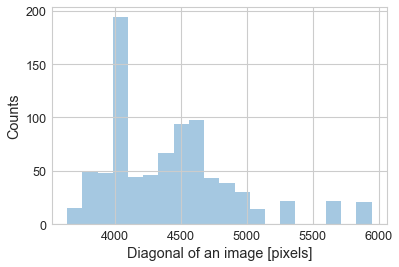

In [71]:
g = sns.distplot(df_area['diag'], kde = False);
g.set_xlabel('Diagonal of an image [pixels]');
g.set_ylabel('Counts');

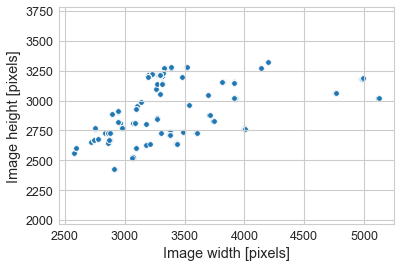

In [72]:
g = sns.scatterplot(x = df_area['width'],y = df_area['height'],);
g.set_xlabel('Image width [pixels]');
g.set_ylabel('Image height [pixels]');
g.set_aspect("equal", adjustable="datalim")

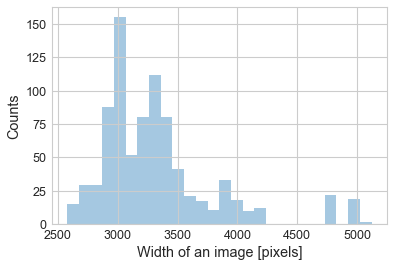

In [73]:
g = sns.distplot(df_area['width'], kde = False);
g.set_xlabel('Width of an image [pixels]');
g.set_ylabel('Counts');

Images seem to have a larger range of sizes in width than in height, but there does not seem to be any strange values. Largest iamge has been checked and there are no particular issues.

In [74]:
large_image_id = df_area[df_area['width']==df_area['width'].max()].index
large_image_id

Index(['727.tif'], dtype='object', name='image_id')

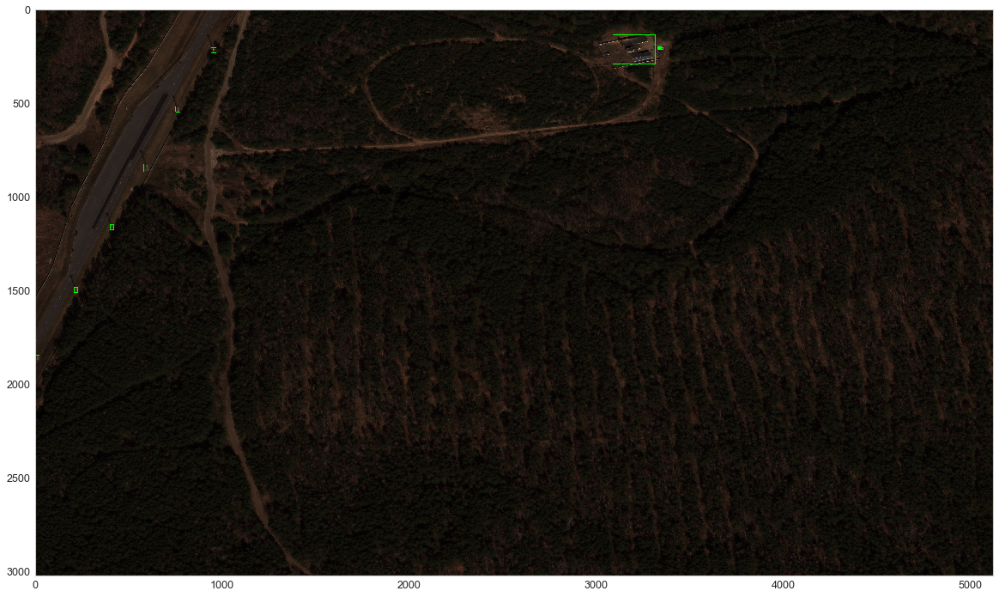

In [75]:
plot_img_w_bbox(df, 727, n_box = None)

In [76]:
len(large_image_id)

1

# Univariate exploration

In [77]:
idx_to_name_map = {'classes':labels_dict, 'parent':parent_dict,'parent_alt':parent_alt_dict}

In [78]:
df_class_count = pd.DataFrame(df.groupby("classes").size().sort_values(ascending=False), columns = ['Total'])
df_class_count['Frequency'] = df_class_count['Total']/df_class_count['Total'].sum()
df_class_count['class_name'] = df_class_count.index
df_class_count['class_name'] = df_class_count['class_name'].map(labels_dict)
df_class_count

,Total,Frequency,class_name
classes,,,
73,316650,0.526263,Building
18,211654,0.351763,Small Car
23,12189,0.020258,Truck
19,6974,0.011591,Bus
24,5897,0.009801,Cargo Truck
83,4266,0.007090,Vehicle Lot
27,4103,0.006819,Trailer
25,3653,0.006071,Truck Tractor w/ Box Trailer
21,3635,0.006041,Utility Truck


In [79]:
class_order = df_class_count.index

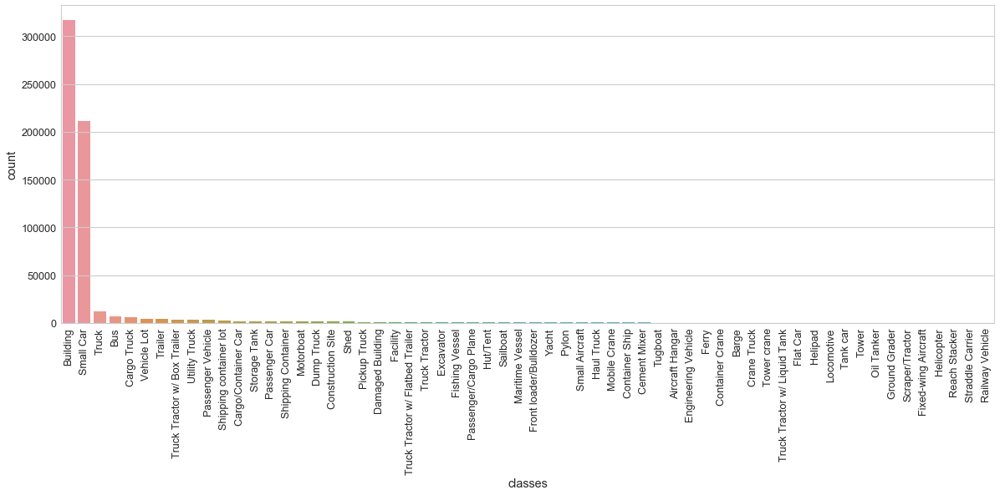

In [80]:
fig, ax = plt.subplots(figsize=(20,7))
sns.countplot(x="classes", data = df, order = class_order)
ax.set_xticklabels([labels_dict[int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

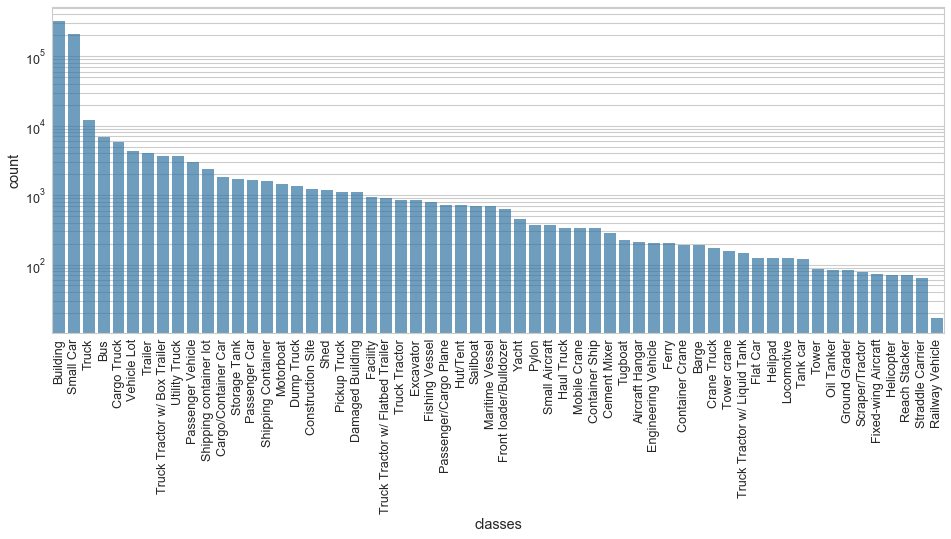

In [81]:
fig, ax = plt.subplots(figsize=(16,6))
sns.countplot(x="classes", data = df, order = class_order, color = sns.color_palette()[0], alpha = 0.7)
ax.set_yscale('log')
ax.yaxis.grid(True, which='minor')
ax.set_xticklabels([labels_dict[int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);
ax.set_axisbelow(True);

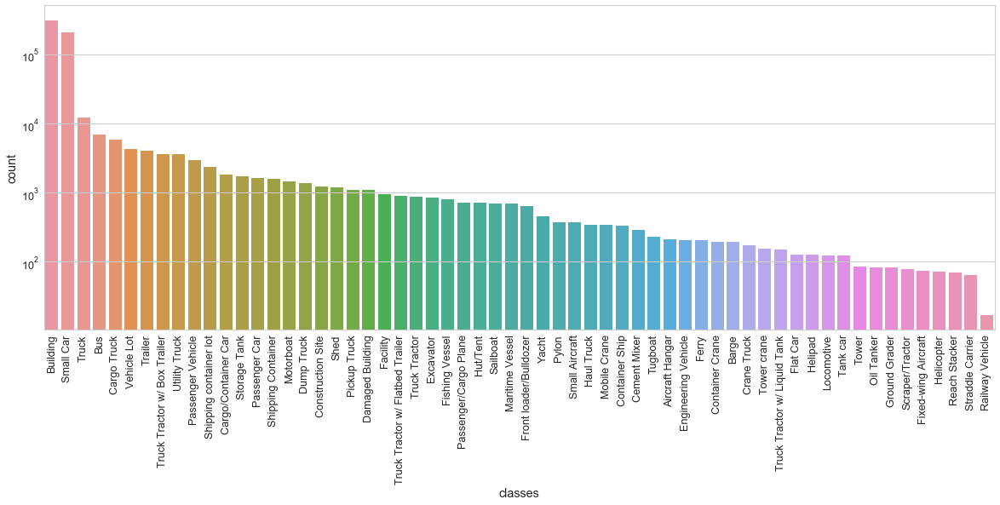

In [82]:
fig, ax = plt.subplots(figsize=(20,7))
sns.countplot(x="classes", data = df, order = class_order)
ax.set_yscale('log')
ax.set_xticklabels([labels_dict[int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

There are huge differences in the number of occurrences of child classes, class imbalance is quite important. The most found class is **Building**, with almost 320k occurrences, and the least represented is **Railway Vehicle**, with only 17 occurrences. It shall be noted that both Building and Railway Vehicle are parent classes actually, and not child classes. Building has 18k times more occurrences than Railway Vehicle.

The two most common classes, building and small car, represent roughly an 87% of the objects found in the dataset.

## Univariate exploration - parent classes

In [83]:
df_p_class_count = pd.DataFrame(df.groupby("parent").size().sort_values(ascending=False), columns = ['Total'])
df_p_class_count['Frequency'] = df_p_class_count['Total']/df_p_class_count['Total'].sum()
df_p_class_count['class_name'] = df_p_class_count.index
df_p_class_count['class_name'] = df_p_class_count['class_name'].map(parent_dict)
df_p_class_count

,Total,Frequency,class_name
parent,,,
73,320811,0.533179,Building
17,221582,0.368263,Passenger Vehicle
23,32488,0.053994,Truck
-1,11822,0.019648,None
40,5141,0.008544,Maritime Vessel
53,4821,0.008012,Engineering Vehicle
33,3870,0.006432,Railway Vehicle
11,1160,0.001928,Fixed-wing Aircraft


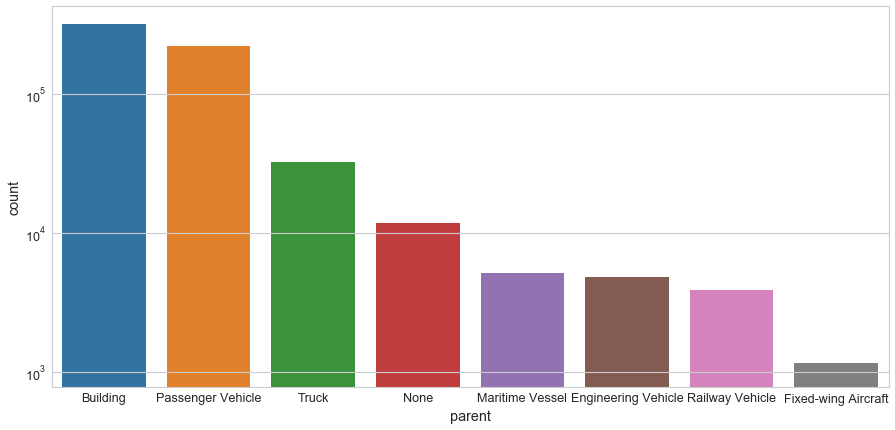

In [84]:
p_class_order = df_p_class_count.index
fig, ax = plt.subplots(figsize=(15,7))
ax.set_yscale('log')
sns.countplot(x="parent", data = df, order = p_class_order)
ax.set_xticklabels([parent_dict[int(key.get_text())] for key in ax.get_xticklabels()]);

In [85]:
320811-316650

4161

It is interesting to note, that building parent class contains only 4161 more objects from its child classes than when considering Building class alone. This means that most objects of building parent class, had not a child class assigned. This raises concern as to if the Building child classes have been chosen conveniently, or if its just too hard distinguishing Building types.

On the other hand, railway vehicle parent class has increased importantly, from 17 to 3870. This means that in the case of this parent class, most objects found in the dataset were labelled by one of the child classes and only a few could not found an appropriate child label.

## Univariate exploration - parent alternative classes

In [86]:
df_p_class_count = pd.DataFrame(df.groupby("parent_alt").size().sort_values(ascending=False), columns = ['Total'])
df_p_class_count['Frequency'] = df_p_class_count['Total']/df_p_class_count['Total'].sum()
df_p_class_count['class_name'] = df_p_class_count.index
df_p_class_count['class_name'] = df_p_class_count['class_name'].map(parent_alt_dict)
df_p_class_count

,Total,Frequency,class_name
parent_alt,,,
73,320811,0.533179,Building
17,221582,0.368263,Passenger Vehicle
23,32488,0.053994,Truck
40,5141,0.008544,Maritime Vessel
53,4821,0.008012,Engineering Vehicle
83,4266,0.007090,Vehicle Lot
33,3870,0.006432,Railway Vehicle
89,2379,0.003954,Shipping container lot
86,1712,0.002845,Storage Tank


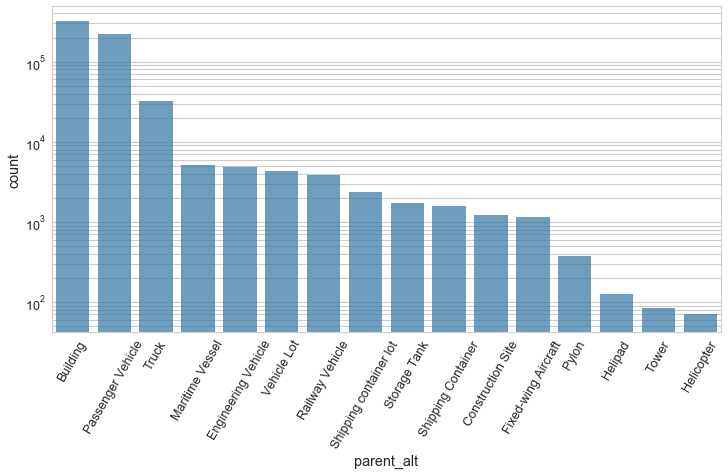

In [87]:
p_class_order = df_p_class_count.index
fig, ax = plt.subplots(figsize=(12,6))
ax.set_yscale('log')
sns.countplot(x="parent_alt", data = df, order = p_class_order,color = sns.color_palette()[0], alpha = 0.7)
ax.yaxis.grid(True, which='minor')
ax.set_xticklabels([parent_alt_dict[int(key.get_text())] for key in ax.get_xticklabels()], rotation = 60);
ax.set_axisbelow(True);

### Bounding boxes sizes

Largest side

In [88]:
df['large_side'] = np.maximum((df.x),(df.y))
df.head()

,x0,y0,x1,y1,image_id,classes,height,width,x,y,parent,parent_alt,large_side
0,2712,1145,2739,1177,2355.tif,73,2667,2739,34,32,73,73,34
1,2720,2233,2739,2288,2355.tif,73,2667,2739,40,55,73,73,55
2,2687,1338,2739,1399,2355.tif,73,2667,2739,53,61,73,73,61
3,2691,1201,2730,1268,2355.tif,73,2667,2739,39,67,73,73,67
4,2671,838,2714,869,2355.tif,73,2667,2739,43,31,73,73,43


Diagonal calculation

In [89]:
df['diag'] = np.sqrt((df.x1-df.x0)**2 + (df.y1-df.y0)**2)

Aspect ratio

In [90]:
df['aspect_ratio'] = (df.x1-df.x0)/(df.y1-df.y0)

In [91]:
df.aspect_ratio.describe()

count    601695.000000
mean          1.279628
std           1.044682
min           0.002611
25%           0.833333
50%           1.133333
75%           1.545455
max         258.000000
Name: aspect_ratio, dtype: float64

In [92]:
df['aspect_ratio'] = np.where(df['aspect_ratio']<1 , 1/df['aspect_ratio'] , df['aspect_ratio'])

In [93]:
df.aspect_ratio.describe()

count    601695.000000
mean          1.570685
std           1.319067
min           1.000000
25%           1.160000
50%           1.375000
75%           1.750000
max         383.000000
Name: aspect_ratio, dtype: float64

In [94]:
df[['diag','aspect_ratio']].describe()

,diag,aspect_ratio
count,601695.000000,601695.000000
mean,51.512687,1.570685
std,56.595107,1.319067
min,1.414214,1.000000
25%,19.849433,1.160000
50%,36.124784,1.375000
75%,64.443774,1.750000
max,2735.448958,383.000000


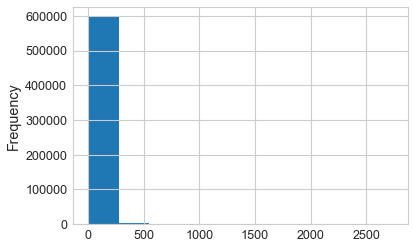

In [95]:
df.diag.plot.hist()

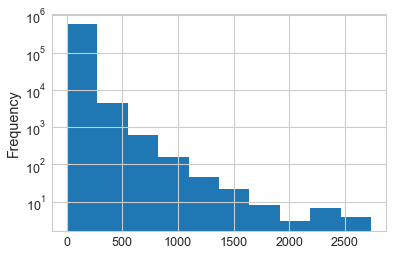

In [96]:
df.diag.plot.hist(log = True)

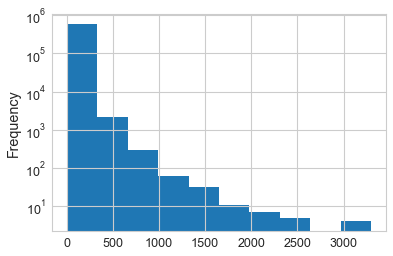

In [97]:
df.large_side.plot.hist(log = True)

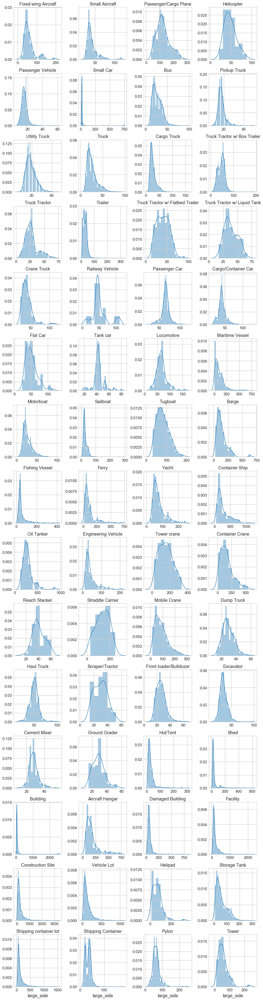

In [98]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
g = sns.FacetGrid(df, col="classes", col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.distplot, "large_side")
for ax in g.axes:
    ax.set_title(labels_dict[int(ax.get_title()[10:])])

Possible outlier for small car. Maybe some more?

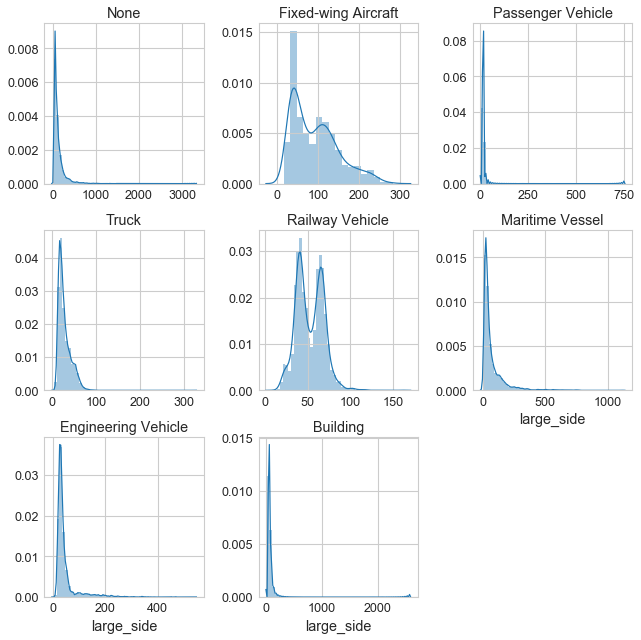

In [99]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
g = sns.FacetGrid(df, col="parent", col_wrap=3, sharex=False, sharey=False, despine = False)
g.map(sns.distplot, "large_side")

for ax in g.axes:
    ax.set_title(parent_dict[int(ax.get_title()[9:])])

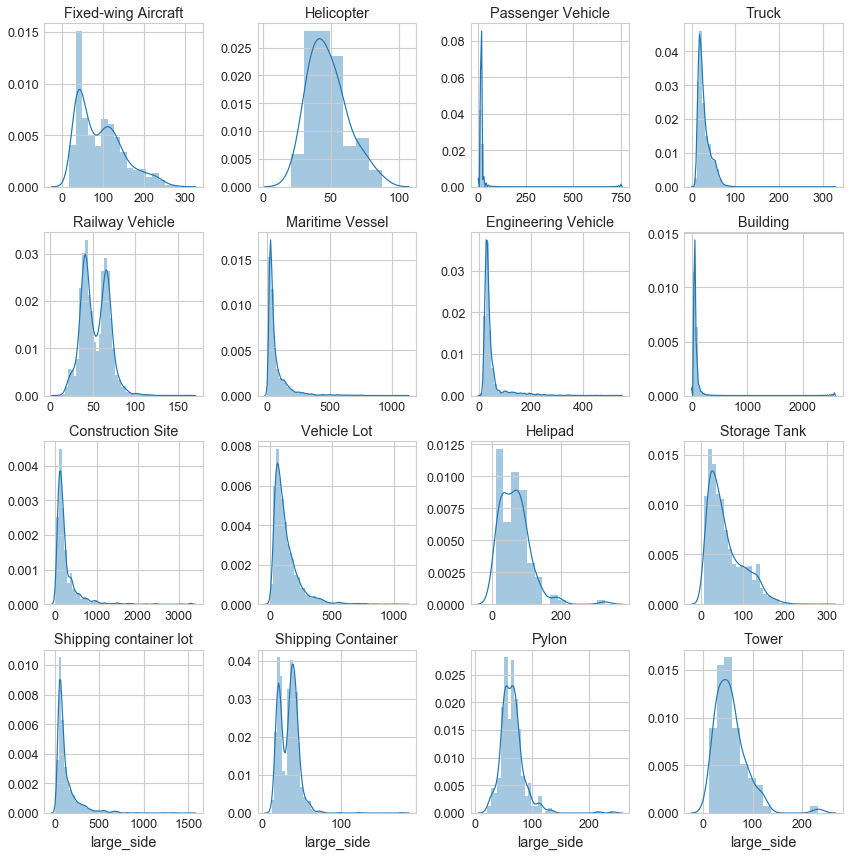

In [100]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
col = "parent_alt"
g = sns.FacetGrid(df, col=col, col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.distplot, "large_side")
for ax in g.axes:
    ax.set_title(parent_alt_dict[int(ax.get_title()[len(col)+3:])])

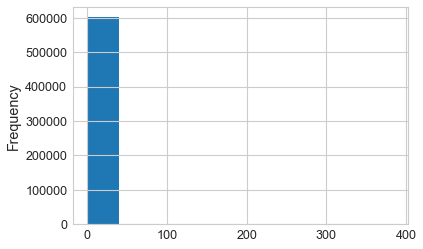

In [101]:
df.aspect_ratio.plot.hist()

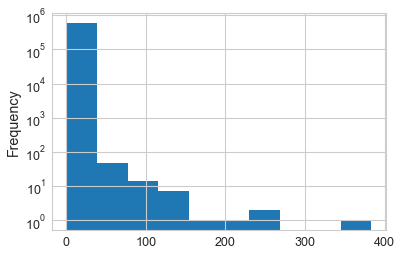

In [102]:
df.aspect_ratio.plot.hist(log=True)

#### Bboxes aspect ratio

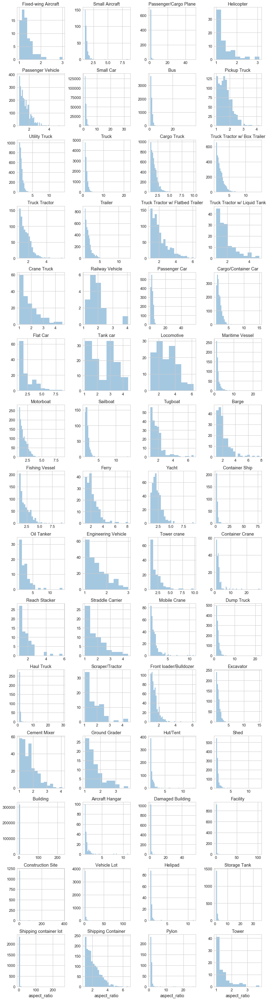

In [103]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
g = sns.FacetGrid(df, col="classes", col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.distplot, "aspect_ratio", kde=False)
for ax in g.axes:
    ax.set_title(labels_dict[int(ax.get_title()[10:])])

As we can see, some bounding boxes reach quite large values for the aspect ratio of the bounding box. It might be due to erroneous definition of the box, or it can be cases for which the object has been cropped at the image borders.

# Do some cleaning based on this?

### Bivariate exploration

In [104]:
col_y = "large_side"

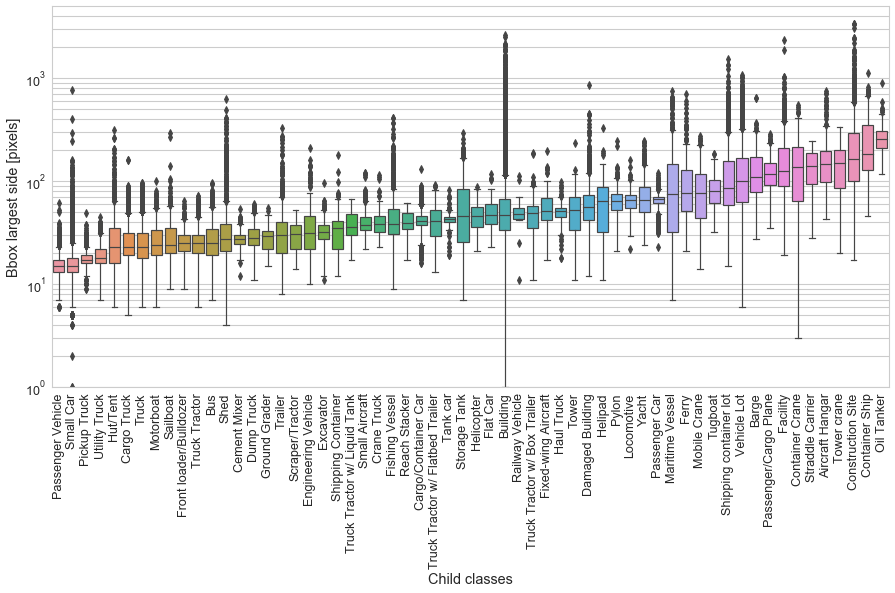

In [173]:
col_x = "classes"

categories_in_x = np.unique(df[col_x])
median_cat = np.zeros(len(categories_in_x))
for i, cat in enumerate(categories_in_x):
    mask = df[col_x]==cat
    median_cat[i] = np.median(df[mask][col_y])

order = categories_in_x[np.argsort(median_cat)]


fig, ax = plt.subplots(figsize=(15,7))
ax.yaxis.grid(True, which='minor')
sns.boxplot(x=col_x, y = col_y, data = df, order = order)
ax.set_yscale("log")
ax.set_xticklabels([labels_dict[int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);
ax.set_axisbelow(True)
ax.set_ylim(ymin = 1);
ax.set_xlabel("Child classes")
ax.set_ylabel("Bbox largest side [pixels]");

There are some classes that attain some unrealistic values (if the satellite images are all at the same resolution), which is the case in principle. There are some Small Cars that go almost to 1000px in size.

Building class seems to be the largest in range of sizes. This makes sense, considering that it is a class that has many occurrences and that its child classes were barely used.

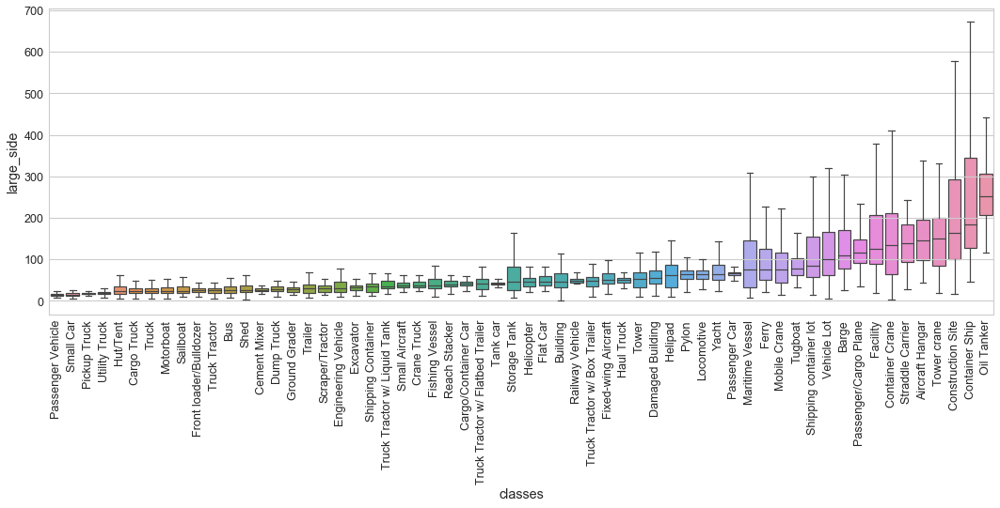

In [106]:
fig, ax = plt.subplots(figsize=(18,6))
sns.boxplot(x=col_x, y = col_y, data = df, order = order, showfliers = False)
ax.set_xticklabels([idx_to_name_map[col_x][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

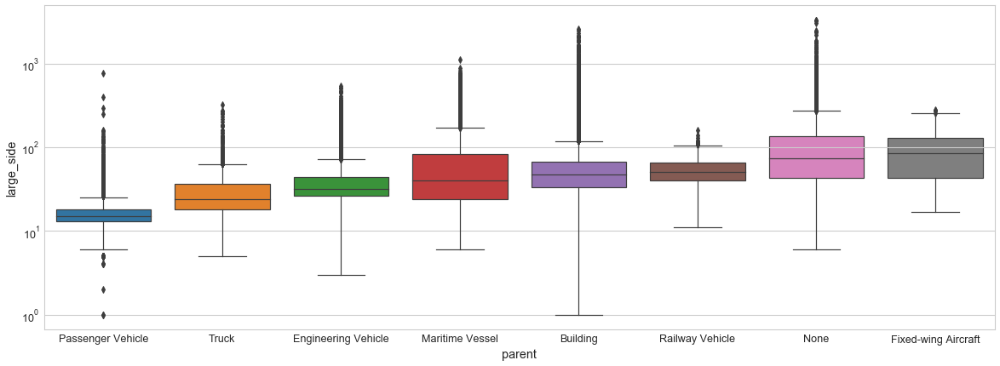

In [107]:
col_x = "parent"

categories_in_x = np.unique(df[col_x])
median_cat = np.zeros(len(categories_in_x))
for i, cat in enumerate(categories_in_x):
    mask = df[col_x]==cat
    median_cat[i] = np.median(df[mask][col_y])

order = categories_in_x[np.argsort(median_cat)]


fig, ax = plt.subplots(figsize=(20,7))
sns.boxplot(x=col_x, y = col_y, data = df, order = order)
ax.set_yscale("log")
ax.set_xticklabels([idx_to_name_map[col_x][int(key.get_text())] for key in ax.get_xticklabels()]);

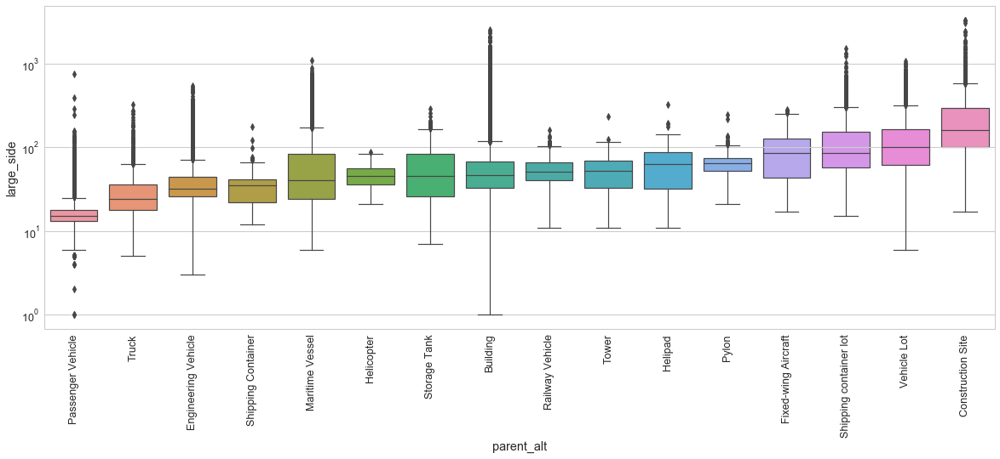

In [108]:
col_x = "parent_alt"

categories_in_x = np.unique(df[col_x])
median_cat = np.zeros(len(categories_in_x))
for i, cat in enumerate(categories_in_x):
    mask = df[col_x]==cat
    median_cat[i] = np.median(df[mask][col_y])

order = categories_in_x[np.argsort(median_cat)]


fig, ax = plt.subplots(figsize=(20,7))
sns.boxplot(x=col_x, y = col_y, data = df, order = order)
ax.set_yscale("log")
ax.set_xticklabels([idx_to_name_map[col_x][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

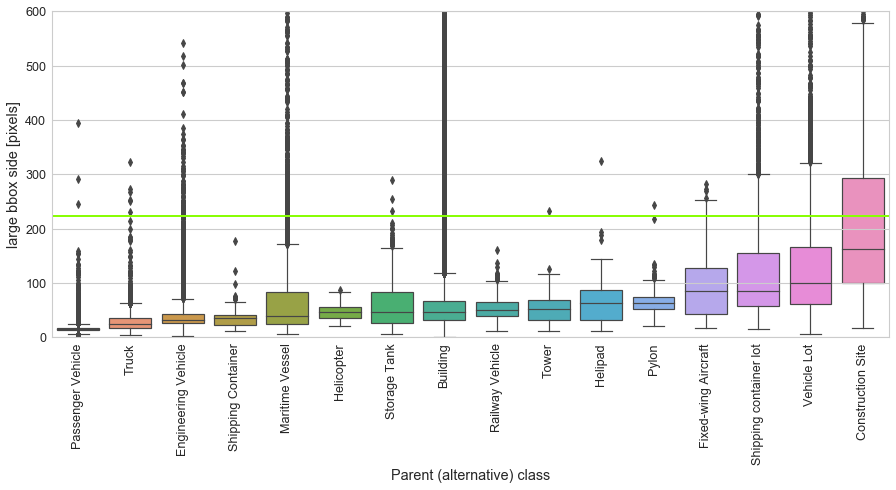

In [109]:
fig, ax = plt.subplots(figsize=(15,6))
sns.boxplot(x=col_x, y = col_y, data = df, order = order, showfliers = True)
ax.set_xticklabels([idx_to_name_map[col_x][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);
ax.axhline(224, color = "xkcd:lime green", linewidth = 2)
ax.set_xlabel('Parent (alternative) class')
ax.set_ylabel('large bbox side [pixels]')

ax.set_ylim([0,600]);

In [110]:
len(df)

601695

Is there much more dispersion in the data when using the parent classes? Because that would allow having more samples per class and facilitate training.

In [111]:
def percentile(n):
    def percentile_(x):
        return x.quantile(n)
    percentile_.__name__ = 'percentile_{:02.0f}'.format(n*100)
    return percentile_

In [112]:
col = 'classes'
ops_list = [np.mean, np.std, percentile(0.1), percentile(0.25), np.median, percentile(0.75), percentile(0.9)]
df_class_stats = df[[col,'diag']].groupby(col).aggregate(ops_list)

# df_class_stats['class_name'] = df_class_stats.index
# df_class_stats['class_name'] = df_class_stats['class_name'].map(idx_to_name_map[col])
df_class_stats.index = df_class_stats.index.map(idx_to_name_map[col])
df_class_stats.style.format("{:.0f}")

In [113]:
np.sqrt(np.sum(df_class_stats[('diag','std')]**2/len(df_class_stats)))

74.76267341062085

In [114]:
col = 'parent_alt'
ops_list = ['size', np.mean, np.std, percentile(0.1), percentile(0.25), np.median, percentile(0.75), percentile(0.9)]
df_class_stats = df[[col,'diag']].groupby(col).aggregate(ops_list)

# df_class_stats['class_name'] = df_class_stats.index
# df_class_stats['class_name'] = df_class_stats['class_name'].map(idx_to_name_map[col])
df_class_stats.index = df_class_stats.index.map(idx_to_name_map[col])
df_class_stats.style.format("{:.0f}")

In [115]:
np.sqrt(np.sum(df_class_stats[('diag','std')]**2/len(df_class_stats)))

99.92922880985628

The diagonal standard deviation is larger, in average, when th alternative parent classification is used, around a 30%. Still,...

How to choose the chip size?

How many bboxes are below a given size?

In [116]:
quant_range = np.arange(0.1,1,0.1)
quant_range = np.hstack((quant_range, 0.95))
df.diag.quantile(quant_range)

0.10     16.155494
0.20     18.601075
0.30     21.400935
0.40     26.172505
0.50     36.124784
0.60     46.861498
0.70     58.008620
0.80     72.180330
0.90     98.473347
0.95    131.893897
Name: diag, dtype: float64

And at a class level?

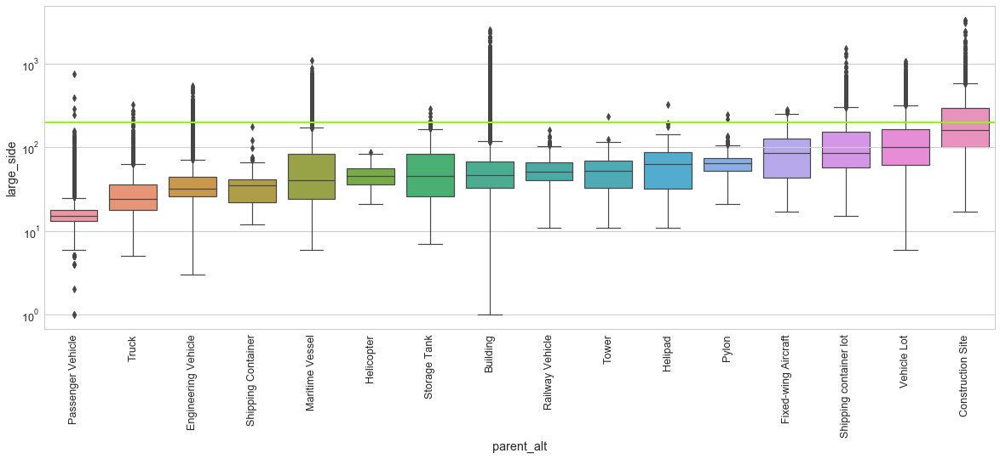

In [117]:
fig, ax = plt.subplots(figsize=(20,7))
sns.boxplot(x=col_x, y = col_y, data = df, order = order, showfliers = True)
ax.set_yscale("log")
ax.set_xticklabels([idx_to_name_map[col_x][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);
ax.axhline(200, color = "xkcd:lime green", linewidth = 2)

The decided chip size is of 200. This for all classes but 1, more than 75% of bounding boxes for all classes but one is below this size. This would imply that a given object is only split in two pieces, except for those larger than 200 pixels. Construction Site class will have more objects split into more than 2 pieces. We will see if performance is significantly worse.

#### Scatter plots

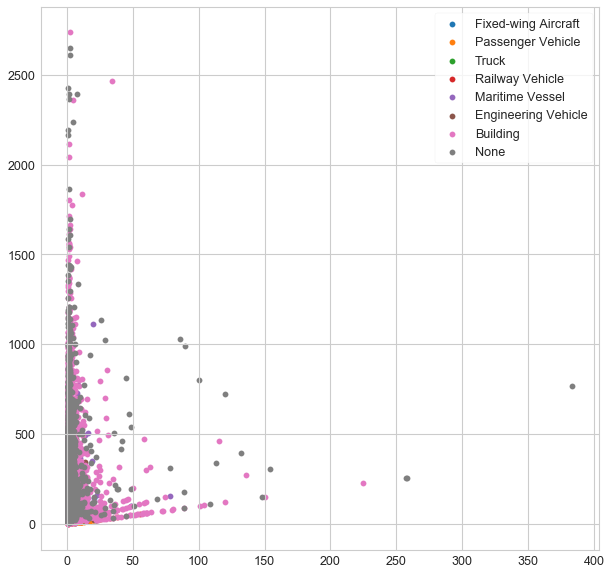

In [118]:
fig, ax = plt.subplots(figsize=(10,10))
for p in parent_dict.keys():
    ax.scatter(x="aspect_ratio", y = "diag", data = df[df['parent']==p], label = parent_dict[p])

plt.legend()

It seems that extreme values of aspect ratio are encountered by passenger vehicle parent class
We now have a look at some of the weird values?

Bivariate exploration, scatter plots by parent class

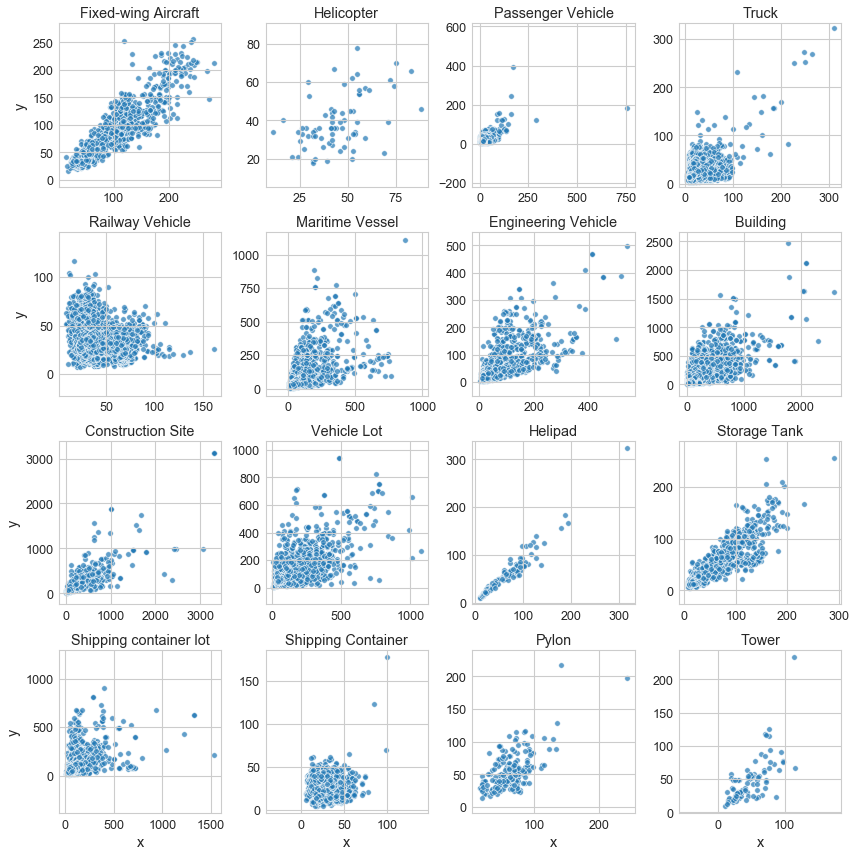

In [119]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
col = "parent_alt"
g = sns.FacetGrid(df, col=col, col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.scatterplot, "x", "y", alpha= 0.7)
for ax in g.axes:
    ax.set_title(idx_to_name_map[col][int(ax.get_title()[len(col)+3:])])
    ax.set_aspect("equal", adjustable="datalim")

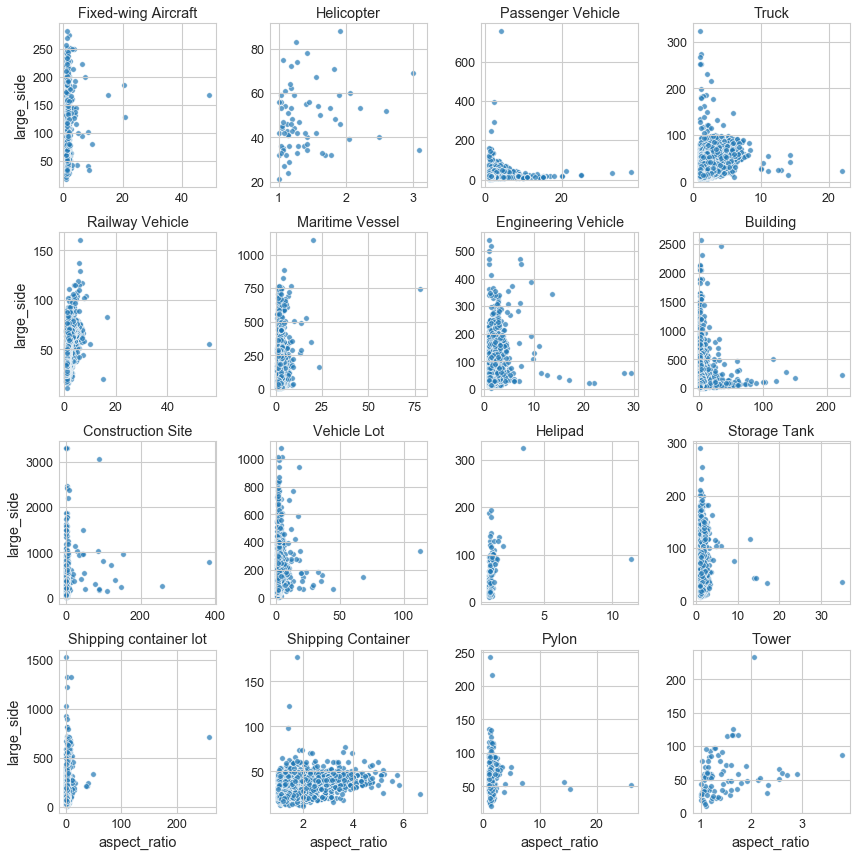

In [120]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
col = "parent_alt"
g = sns.FacetGrid(df, col=col, col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.scatterplot, "aspect_ratio", "large_side", alpha= 0.7)
for ax in g.axes:
    ax.set_title(idx_to_name_map[col][int(ax.get_title()[len(col)+3:])])

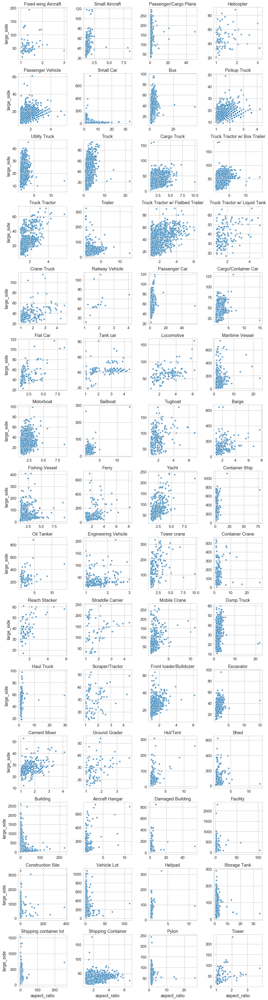

In [121]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
col = "classes"
g = sns.FacetGrid(df, col=col, col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.scatterplot, "aspect_ratio", "large_side", alpha= 0.7)
for ax in g.axes:
    ax.set_title(idx_to_name_map[col][int(ax.get_title()[len(col)+3:])])
    

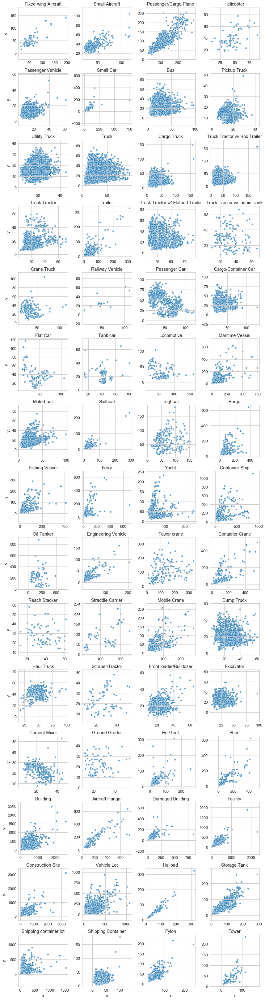

In [122]:
# f = pd.melt(df, id_vars = 'large_side', value_vars = num_features)
col = "classes"
g = sns.FacetGrid(df, col=col, col_wrap=4, sharex=False, sharey=False, despine = False)
g.map(sns.scatterplot, "x", "y", alpha= 0.7)
for ax in g.axes:
    ax.set_title(idx_to_name_map[col][int(ax.get_title()[len(col)+3:])])
    ax.set_aspect("equal", adjustable="datalim")

Have a look at image width and height. And maybe file size

## Conclusions of the EDA

- Huge class imbalance, both for child classes and parent classes
- Large differences between the objects, with sizes that can vary from 10px to 2000px, all classes comprised, or inside a class we find differences in size ...



## Save the cleaned data

In [123]:
len(df)

601695

In [124]:
output_path="xView/final_batch"

In [125]:
df.columns

Index(['x0', 'y0', 'x1', 'y1', 'image_id', 'classes', 'height', 'width', 'x',
       'y', 'parent', 'parent_alt', 'large_side', 'diag', 'aspect_ratio'],
      dtype='object')

In [126]:
cols_export = ['x0', 'y0', 'x1', 'y1', 'image_id', 'classes', 'height', 'width','parent_alt']
df_export = df[cols_export]

In [127]:
filename = "bboxes.csv"
path_export = os.path.join(output_path, filename)
df_export.to_csv(path_export, header=True,index=False)

In [128]:
S3_PATH = "s3://xview-udacity/raw_images/final_batch/"
!aws s3 cp "{path_export}" "{S3_PATH}"

upload failed: xView/final_batch/bboxes.csv to s3://xview-udacity/raw_images/final_batch/bboxes.csv An error occurred (InvalidToken) when calling the CreateMultipartUpload operation: The provided token is malformed or otherwise invalid.


# Exploring some individual images

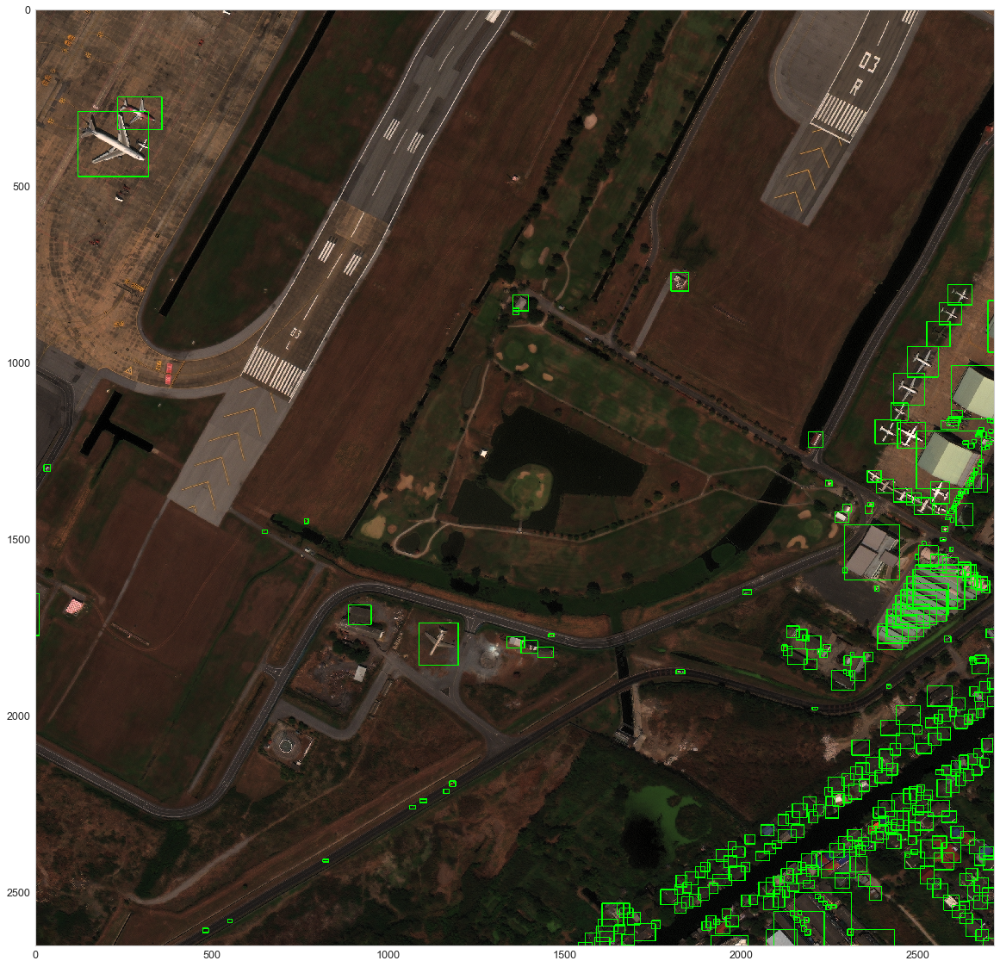

In [129]:
img_idx = 2145 # 2405
plot_img_w_bbox(df, img_idx, n_box = "max")

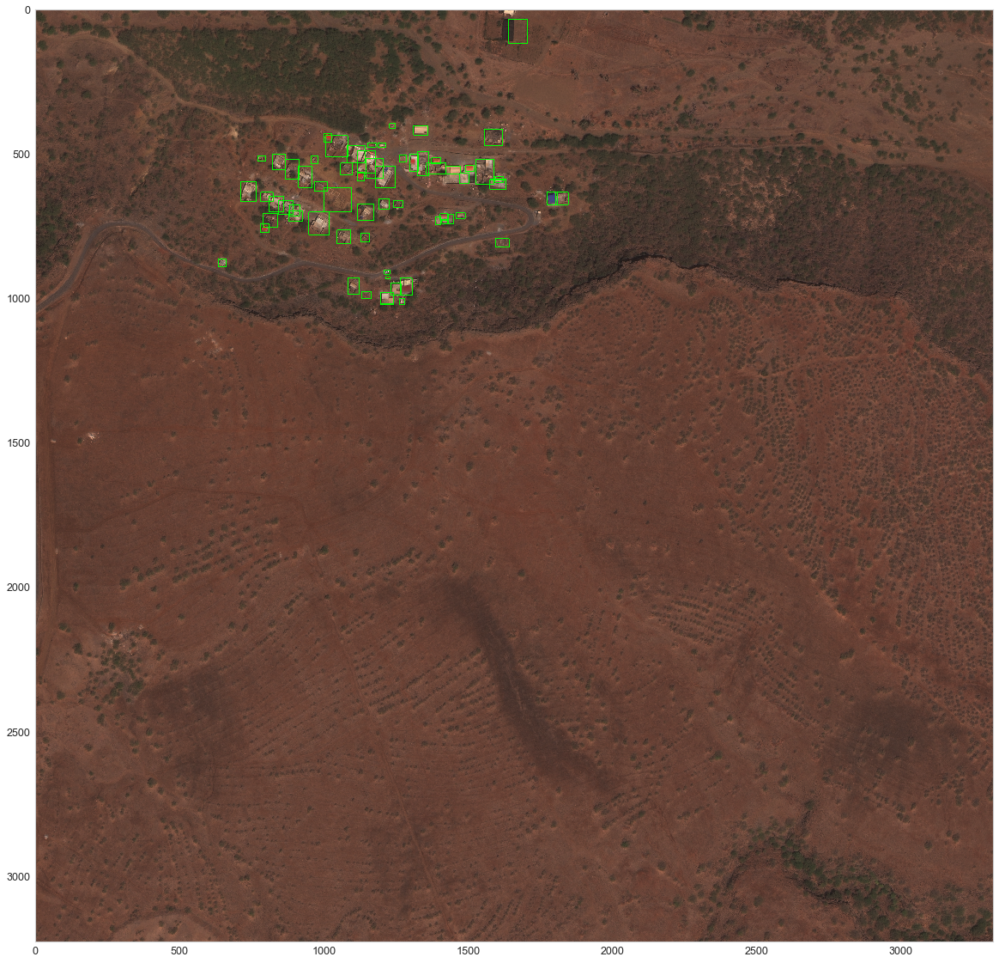

In [130]:
img_idx = 10 # 2405
plot_img_w_bbox(df, img_idx, n_box = "max")

In [131]:
df_img_bbox_count = df.groupby('image_id').size().sort_values()
df_img_bbox_count

image_id
401.tif        1
374.tif        1
567.tif        1
422.tif        1
437.tif        1
            ... 
1109.tif    5346
1217.tif    5609
1080.tif    5736
1106.tif    5750
1831.tif    7618
Length: 846, dtype: int64

In [174]:
df_img_bbox_count

image_id
401.tif        1
374.tif        1
567.tif        1
422.tif        1
437.tif        1
            ... 
1109.tif    5346
1217.tif    5609
1080.tif    5736
1106.tif    5750
1831.tif    7618
Length: 846, dtype: int64

Text(0, 0.5, 'Counts')

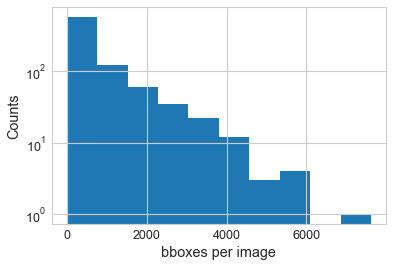

In [178]:
fig, ax = plt.subplots()
plt.hist(df_img_bbox_count)
ax.set_yscale("log")
ax.set_xlabel("bboxes per image")
ax.set_ylabel("Counts")

There are some images really cluttered with objects, and some others with just one object.

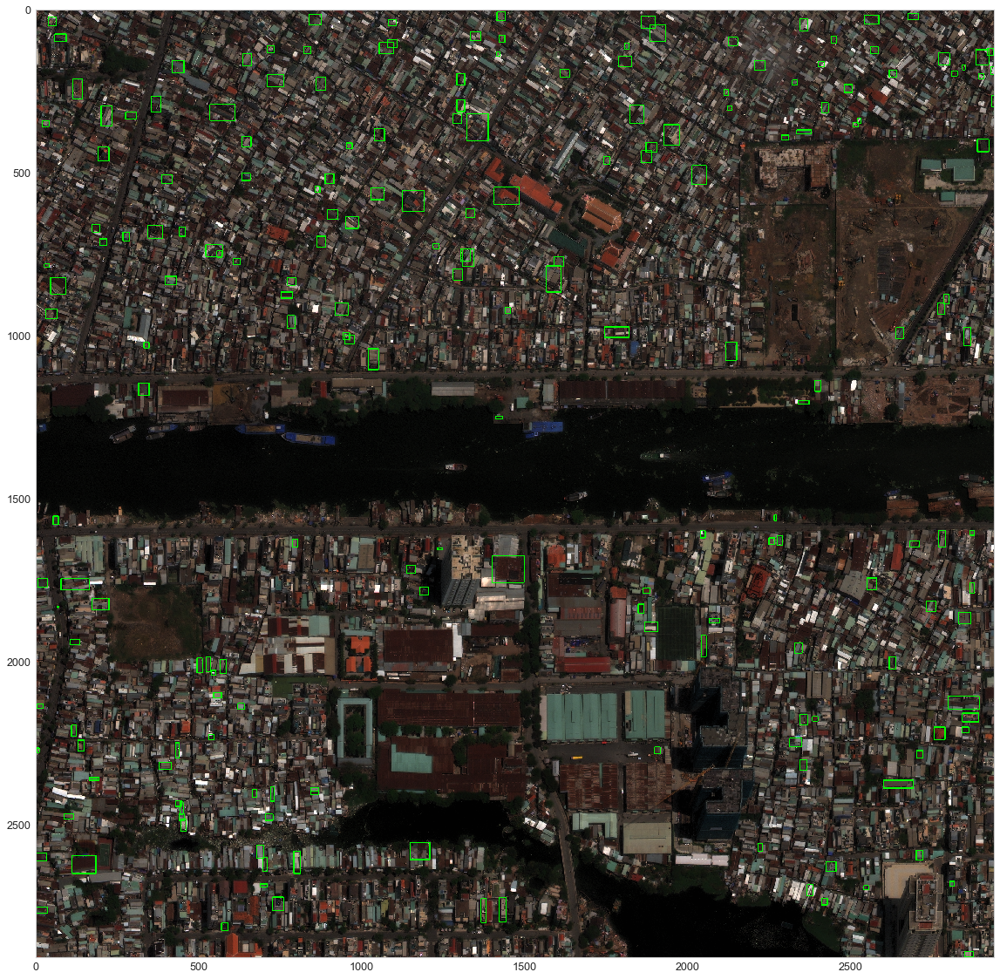

In [132]:
img_idx = 1831 # 2405
plot_img_w_bbox(df, img_idx, n_box = 200)

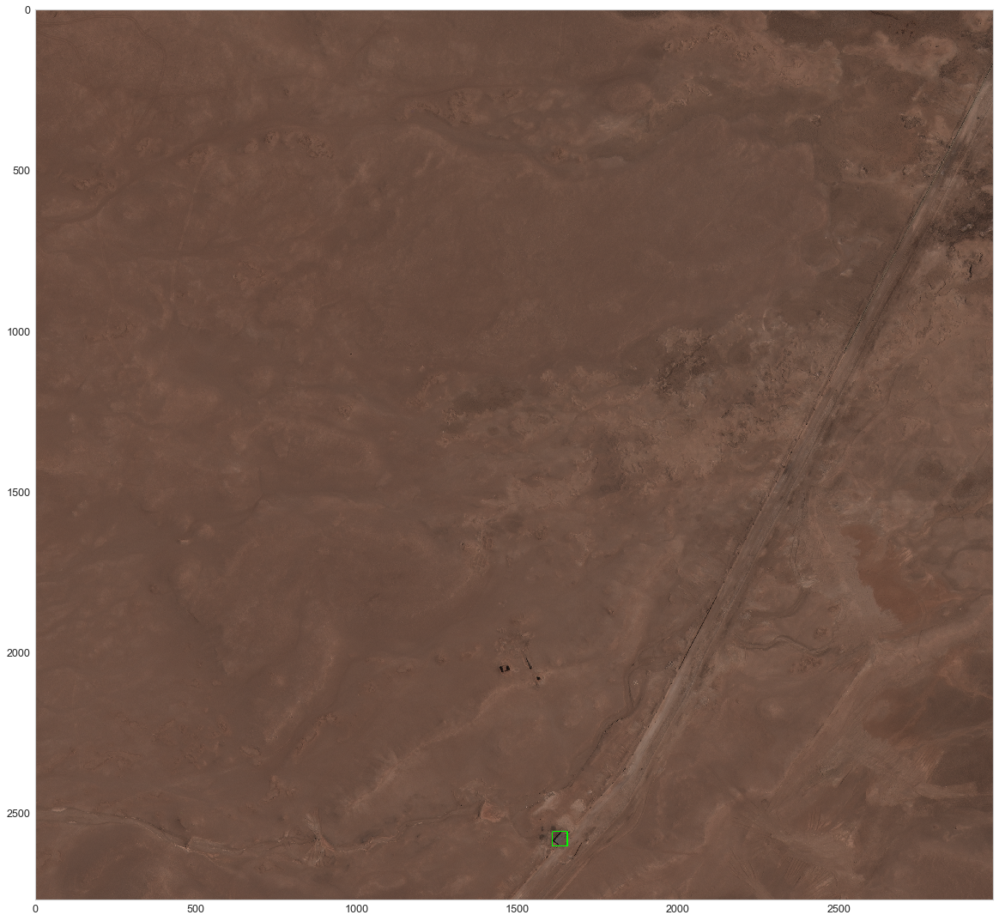

In [133]:
img_idx = 401 # 2405
plot_img_w_bbox(df, img_idx, n_box = "max")

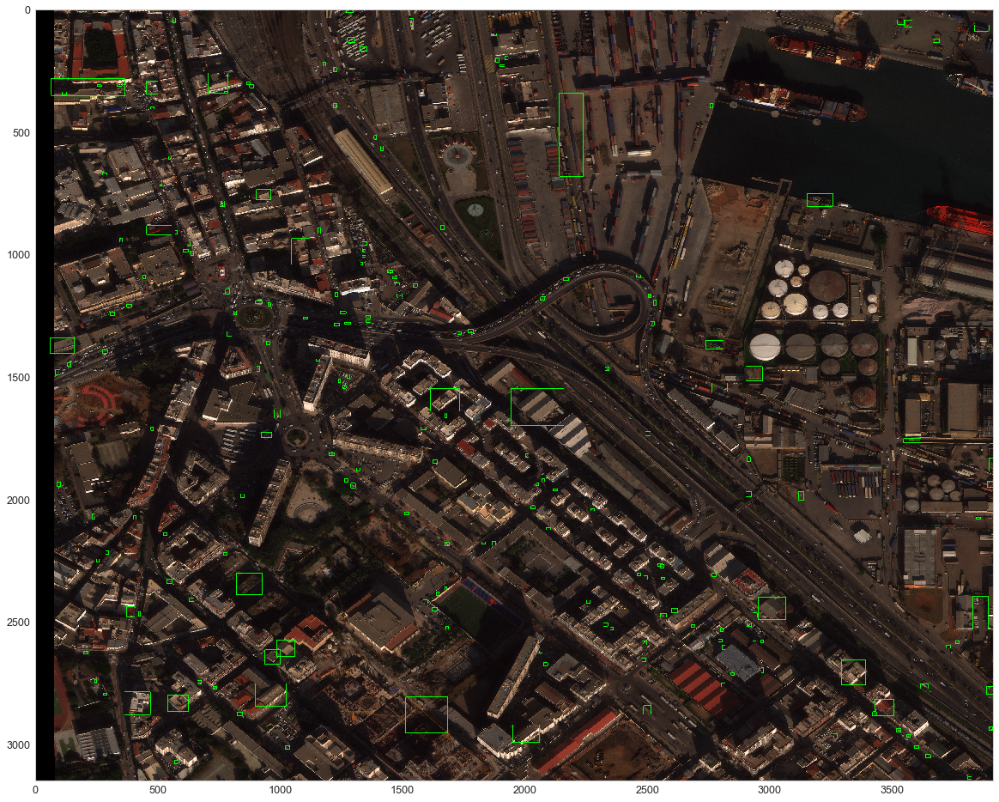

In [134]:
img_idx = 1450 # 2405
plot_img_w_bbox(df, img_idx, n_box = 200)

### Objects samples

Image with more classes

In [135]:
def img_class_count(df, col = "classes"):
    df_img_class_count = df.groupby(['image_id'])[col].nunique()
    df_img_class_count = pd.DataFrame(df_img_class_count).rename(columns={col:'Total'})

    df_img_class_count['Frequency'] = df_img_class_count['Total']/df_img_class_count['Total'].sum()
    return df_img_class_count

In [136]:
df_img_class_count = img_class_count(df, col = "classes")
df_img_class_count.Total.sort_values()

image_id
415.tif      1
2468.tif     1
2495.tif     1
2503.tif     1
2504.tif     1
            ..
1212.tif    32
1920.tif    32
1848.tif    33
1459.tif    33
1450.tif    33
Name: Total, Length: 846, dtype: int64

We can look at the 33 classes in image 1450.tif

In [137]:
img_idx = 1450
img_name = str(img_idx)+'.tif'
df_img = df[df.image_id==img_name].copy()

img_path = ORIG_IMGS_PATH /img_name
img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)

classes_filter_list = df_img.classes.unique()
classes_filter_list

array([79, 89, 23, 18, 73, 25, 51, 27, 86, 77, 53, 60, 63, 64, 66, 54, 19,
       21, 24, 83, 28, 91, 29, 94, 55, 59, 47, 41, 35, 38, 17, 62, 26])

/home/roberto/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


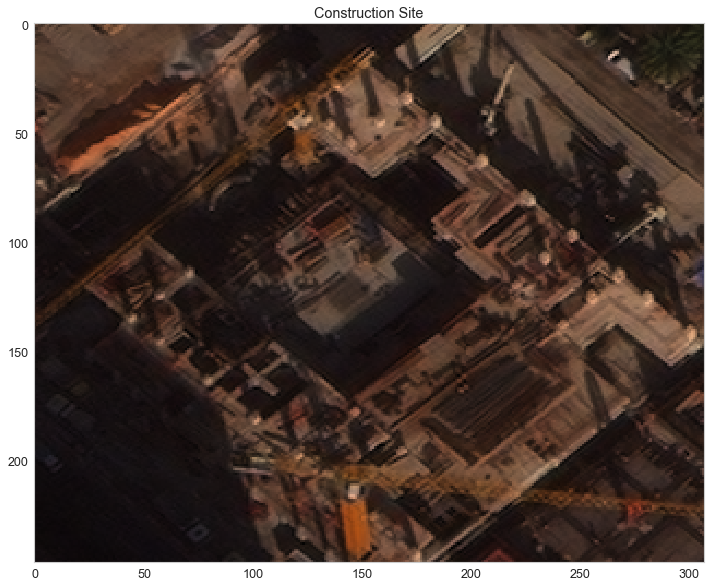

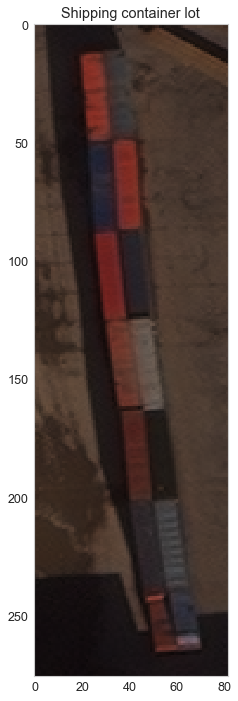

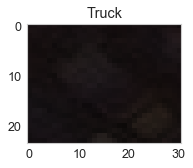

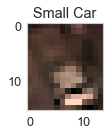

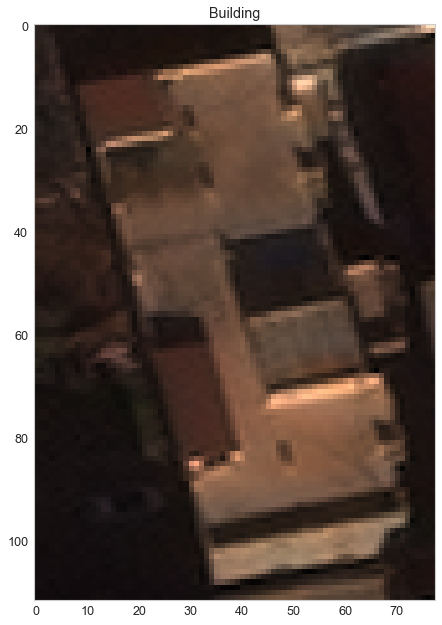

...

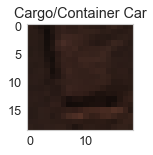

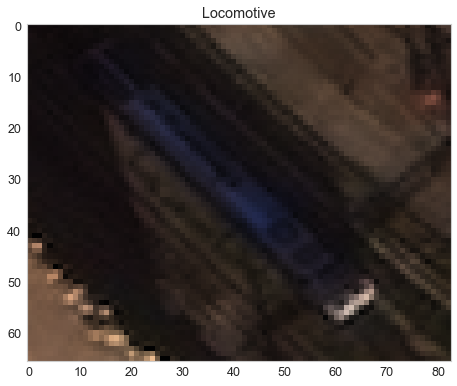

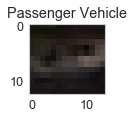

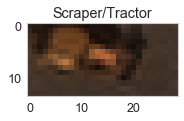

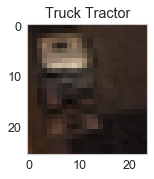

In [138]:
ratio_pix_pp= 10
for class_filter in classes_filter_list:
    df_class = df_img[df_img.classes== class_filter].sample(1)
#     print(df_class.iloc[0,:8])
    
    figsize = np.minimum([12,12],[df_class.x.values[0]/ratio_pix_pp,df_class.y.values[0]/ratio_pix_pp])
    fig , ax = plt.subplots(figsize = figsize)
    plot_bbox(df_class['image_id'].values[0], df_class.iloc[0,:4].values, img = img, ax = ax)
    ax.set_title(labels_dict[class_filter])

<a id='train-test'></a>
# Train -test split

There are 60 classes (or ##, depending on if we chose to work with the child classes or with the parent *alternative* classes), with a huge difference in terms of occurrences per class. Ideally we need samples of each of them for the different train and test sets, and also ideally the proportion of the classes should be closer to the original because...

This problem is identified as multilabel problem. Each image contains many labels. It has been decided to split at image level, and not at chip level. The chips still can contain many labels, and since one of the possibilities considered to tackle this problem was to use a multi-res algorithm, a split at chip level is not possible.

An additional problem are the limited ressources available. Limited AWS credits, no powerful personal computer. Because of that and after some initial tests, training with the full data set has been not considered possible. 

Looking at the same data in table form

In [139]:
def class_count(df, col = "classes"):
    df_class_count = pd.Series(df[col].value_counts(), name='Total')
    df_class_percent = pd.Series(df_class_count/df_class_count.sum(), name='Frequency')
    
    return pd.concat([df_class_count, df_class_percent], axis =1).sort_index()

In [140]:
df_class_count = class_count(df)
df_class_count

,Total,Frequency
11,74,0.000123
12,368,0.000612
13,718,0.001193
15,71,0.000118
17,2954,0.004909
18,211654,0.351763
19,6974,0.011591
20,1103,0.001833
21,3635,0.006041
23,12189,0.020258


What is the distributions of classes through the images? ie in how many images of the total appear each of the classes? One class is counted only once  for an image, even if it appears several times

In [141]:
def class_img_count(df, col = "classes"):
    df_class_img_count = df.groupby([col])['image_id'].nunique()
    df_class_img_count = pd.DataFrame(df_class_img_count).rename(columns={'image_id':'Total'})

    df_class_img_count['Frequency'] = df_class_img_count['Total']/df_class_img_count['Total'].sum()
    return df_class_img_count

In [142]:
df_class_count = class_count(df)
df_class_count

,Total,Frequency
11,74,0.000123
12,368,0.000612
13,718,0.001193
15,71,0.000118
17,2954,0.004909
18,211654,0.351763
19,6974,0.011591
20,1103,0.001833
21,3635,0.006041
23,12189,0.020258


In [143]:
df_class_img_count = class_img_count(df)
df_class_img_count

,Total,Frequency
classes,,
11,29,0.003283
12,57,0.006452
13,119,0.013471
15,25,0.002830
17,204,0.023093
18,691,0.078221
19,447,0.050600
20,212,0.023998
21,355,0.040186


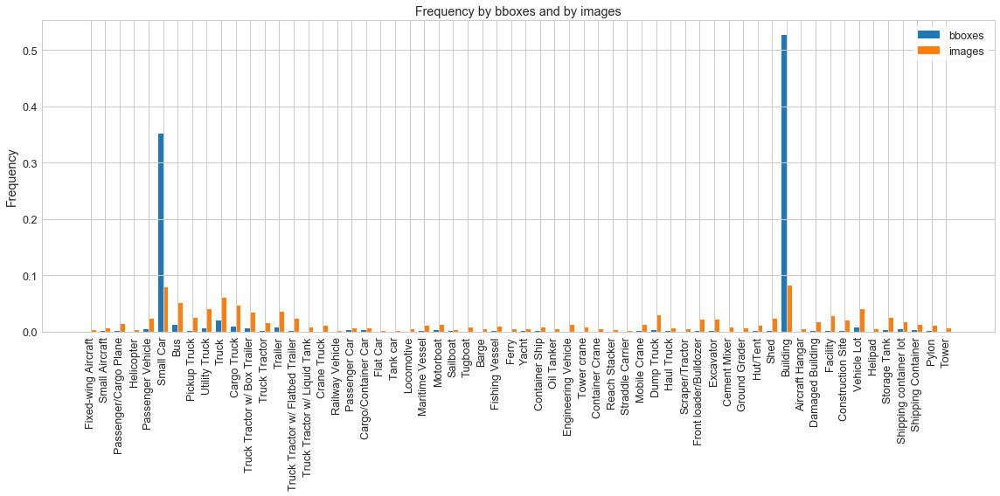

In [144]:
x = np.arange(len(df_class_img_count))  # the label locations
width = 0.35  # the width of the bars
labels = [idx_to_name_map["classes"][index] for index in df_class_img_count.index]
fig, ax = plt.subplots(figsize=(16,8))
rects1 = ax.bar(x - width/2, df_class_count['Frequency'], width, label='bboxes')
rects2 = ax.bar(x + width/2, df_class_img_count['Frequency'], width, label='images')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Frequency')
ax.set_title('Frequency by bboxes and by images')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation = 90)
ax.legend()


fig.tight_layout()


In [146]:
df_class_img_count = df_class_img_count.sort_values(by="Total", ascending = False)


,Total,Frequency
classes,,
73,726,0.082182
18,691,0.078221
23,535,0.060561
19,447,0.050600
24,411,0.046525
83,358,0.040525
21,355,0.040186
27,314,0.035544
25,299,0.033847


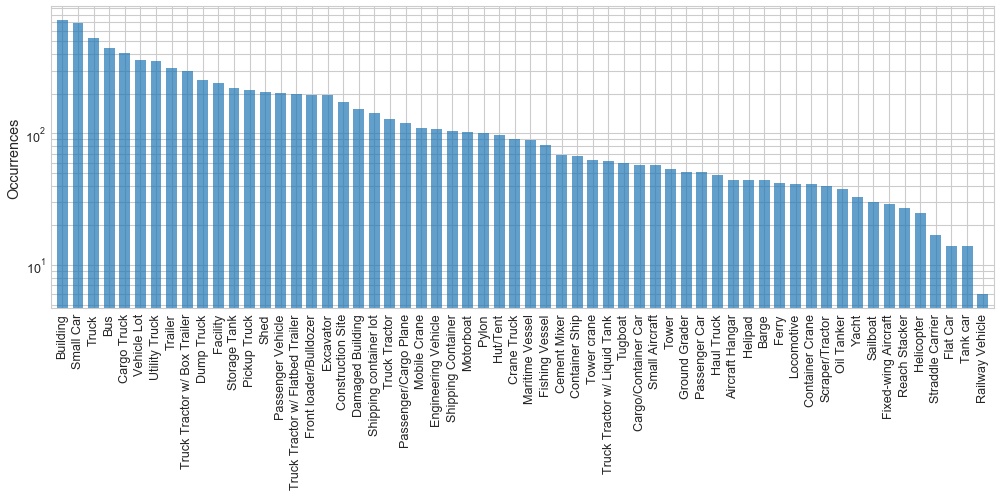

In [159]:

x = np.arange(len(df_class_img_count))  # the label locations
width = 0.7  # the width of the bars
labels = [idx_to_name_map["classes"][index] for index in df_class_img_count.index]
fig, ax = plt.subplots(figsize=(14,7))
rects1 = ax.bar(x, df_class_img_count['Total'], width, alpha = 0.7)

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Occurrences')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation = 90)
ax.set_yscale("log")
ax.yaxis.grid(True, which='minor')
ax.set_axisbelow(True)
ax.set_xlim([0-width, x[-1]+width])

fig.tight_layout()


In [160]:
col = "parent_alt"
df_class_count = class_count(df, col=col)

In [161]:
df_class_img_count = class_img_count(df, col=col)

In [166]:
df_class_img_count = df_class_img_count.sort_values(by="Total", ascending = False)
df_class_img_count

,Total,Frequency
parent_alt,,
73,731,0.176826
17,697,0.168602
23,645,0.156023
53,461,0.111514
83,358,0.086599
86,221,0.053459
79,173,0.041848
40,160,0.038703
89,143,0.034591


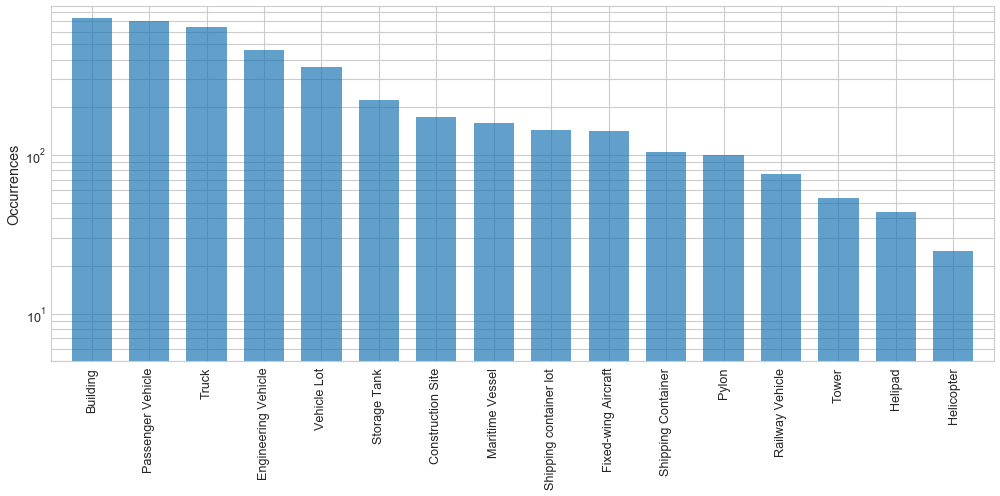

In [165]:

x = np.arange(len(df_class_img_count))  # the label locations
width = 0.7  # the width of the bars
labels = [idx_to_name_map["classes"][index] for index in df_class_img_count.index]
fig, ax = plt.subplots(figsize=(14,7))
rects1 = ax.bar(x, df_class_img_count['Total'], width, alpha = 0.7)

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Occurrences')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation = 90)
ax.set_yscale("log")
ax.yaxis.grid(True, which='minor')
ax.set_axisbelow(True)
ax.set_xlim([0-width, x[-1]+width])
ax.set_ylim(ymin = 5)

fig.tight_layout()


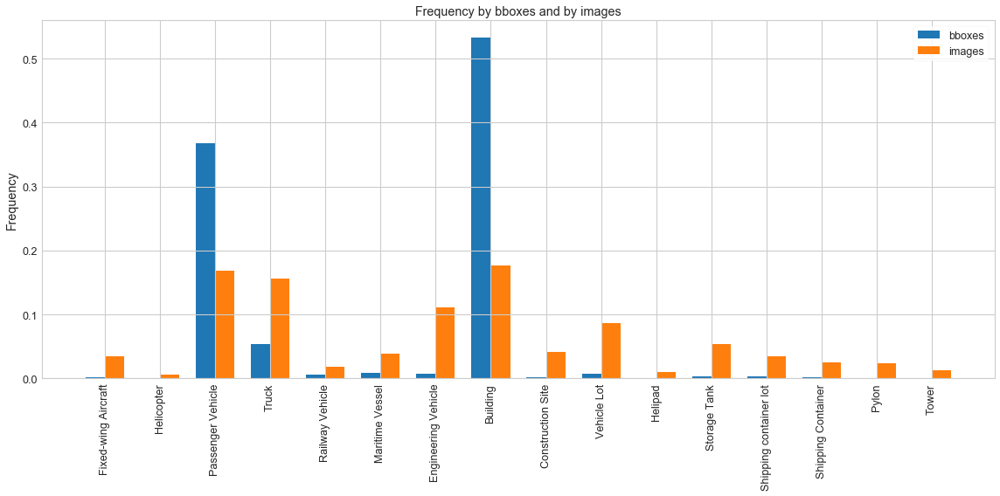

In [213]:
x = np.arange(len(df_class_img_count))  # the label locations
width = 0.35  # the width of the bars
labels = [idx_to_name_map[col][index] for index in df_class_img_count.index]
fig, ax = plt.subplots(figsize=(16,8))
rects1 = ax.bar(x - width/2, df_class_count['Frequency'], width, label='bboxes')
rects2 = ax.bar(x + width/2, df_class_img_count['Frequency'], width, label='images')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Frequency')
ax.set_title('Frequency by bboxes and by images')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation = 90)
ax.legend()


fig.tight_layout()


What happens if we split this into training and testing randomly? How are the classes distributions for both datasets?

## How many images from the total am I going to use?

In [214]:
len(df)

601695

In [216]:
df.image_id.nunique()

846

In [219]:
0.25*846

211.5

## Split tests

In [220]:
def obtain_df_from_image_id(df,image_id_array):
    return df[df['image_id'].isin(image_id_array)]

In [221]:
def add_relative_comparison(df, tgt_column):
    # comparison to full data
    for subset in ['train', 'test']:
        df['rel_diff_'+subset] = (df[tgt_column+"_"+subset])/df[tgt_column]
    # comparison between both splits
    df['rel_train_test'] = df['rel_diff_train']/\
                                        df['rel_diff_test']
    return df

In [222]:
def plot_train_test_split(df, title):
    fig, ax = plt.subplots(figsize = (14,6))
    ax.set_title(title)
    x = range(len(df))
    ax.bar(x, height = df['rel_diff_train'], alpha = 0.6, label = 'train')
    ax.bar(x, height = df['rel_diff_test'], alpha = 0.6, label = 'test')
    ax.set_xticks (range(len(df))), 
    ax.set_xticklabels(df['class_name'].values, rotation = 90)
    plt.legend()

In [224]:
def evaluate_split(df, train_idx, test_idx, col="classes", evaluation_type = 'image_count'):
    
    function_map = {'image_count':class_img_count, 
                    'full_count':class_count}
    
    title_map = {'image_count':"Percentage of images containing the class in the split datasets",
                 'full_count':"Percentage of class bounding boxes in the split datasets"}
    count_fcn = function_map[evaluation_type]
    
    #obtain train and test dataframes
    if train_idx.ndim>1:        
        train_idx = train_idx[:,0]
        test_idx = test_idx[:,0]
    
    df_train = obtain_df_from_image_id(df,train_idx)
    df_test = obtain_df_from_image_id(df,test_idx)
    
    # obtain the class appearances in image basis
    df_full_class_count = count_fcn(df, col = col)
    df_train_class_count = count_fcn(df_train, col = col)
    df_test_class_count = count_fcn(df_test, col = col)
    df_class_count = pd.concat([df_full_class_count, 
                                df_train_class_count.add_suffix("_train"), 
                                df_test_class_count.add_suffix("_test")], 
                               axis=1)
    df_class_count.fillna(0, inplace=True)

    
    df_class_count = add_relative_comparison(df_class_count, 'Frequency')
    
    # add class names
    df_class_count['class_name'] = df_class_count.index
    df_class_count['class_name'] = df_class_count['class_name'].map(labels_dict)
        
    # plot counts image basis
    plot_train_test_split(df_class_count, title=title_map[evaluation_type])
    print(f"\n**************   {evaluation_type}   **************")
    for subset in ["train", "test"]:
        print(f"For {subset} split, mean of Freq of a class divided by the "+
             f"frequency of that class is {df_class_count['rel_diff_'+subset].mean():.3f} "+
              f"and the std = {df_class_count['rel_diff_'+subset].std():.2f}")
    # plot full occurrences counts

### random split

In [238]:
perc_data_to_use = 0.25

In [225]:
from sklearn.model_selection import train_test_split
X_train, X_test = train_test_split(df['image_id'].unique(), test_size = perc_data_to_use)


**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.978 and the std = 0.07
For test split, mean of Freq of a class divided by the frequency of that class is 1.061 and the std = 0.19

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.964 and the std = 0.14
For test split, mean of Freq of a class divided by the frequency of that class is 1.099 and the std = 0.38


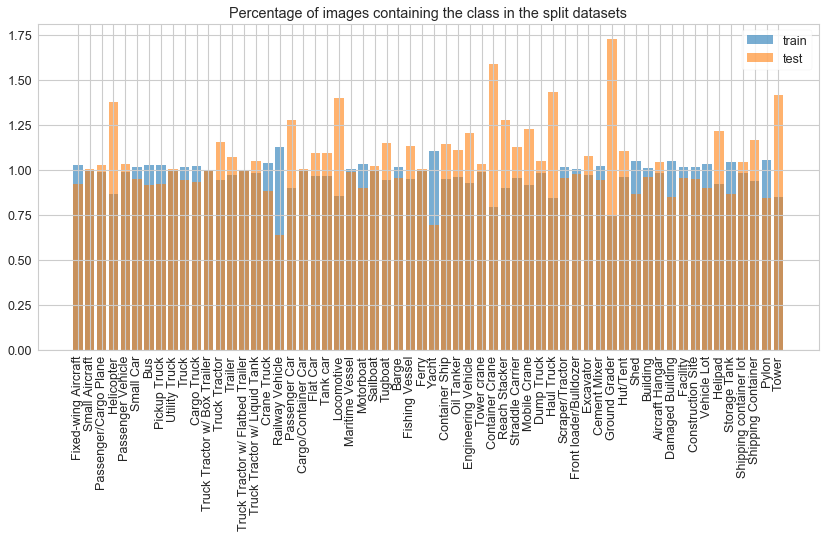

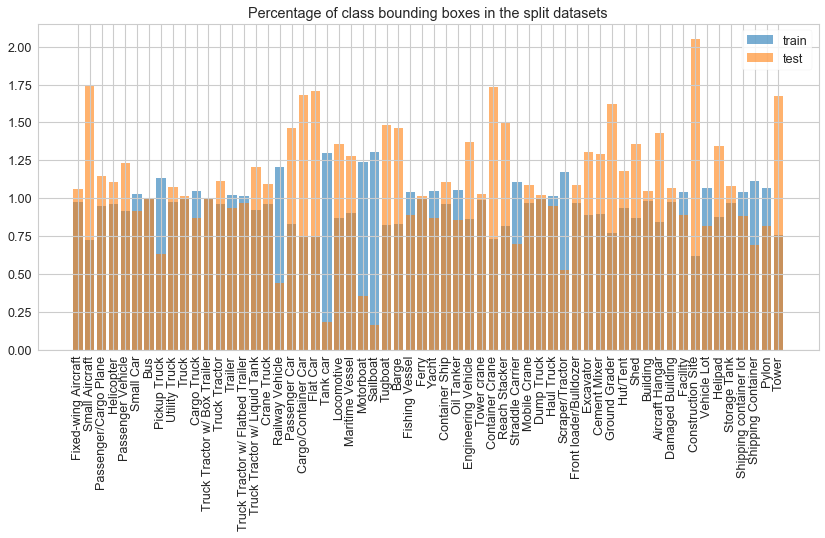

In [226]:
evaluate_split(df, X_train, X_test, evaluation_type = 'image_count')
evaluate_split(df, X_train, X_test, evaluation_type = 'full_count')


**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.974 and the std = 0.06
For test split, mean of Freq of a class divided by the frequency of that class is 1.078 and the std = 0.18

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.951 and the std = 0.13
For test split, mean of Freq of a class divided by the frequency of that class is 1.136 and the std = 0.37


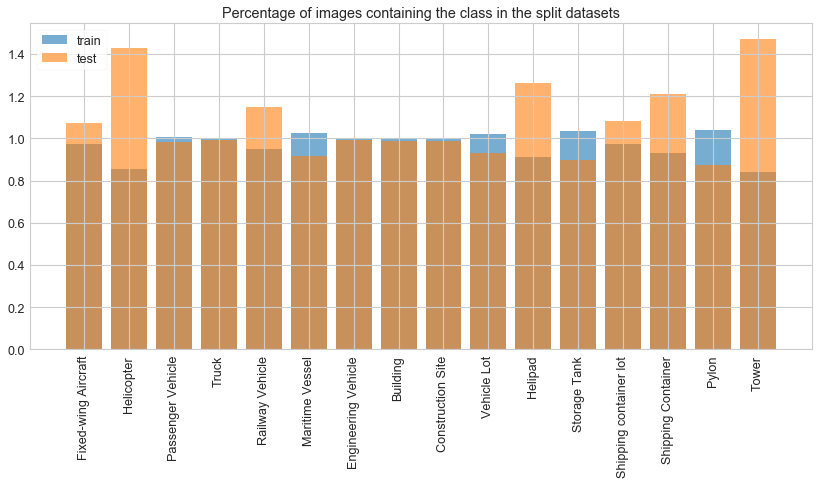

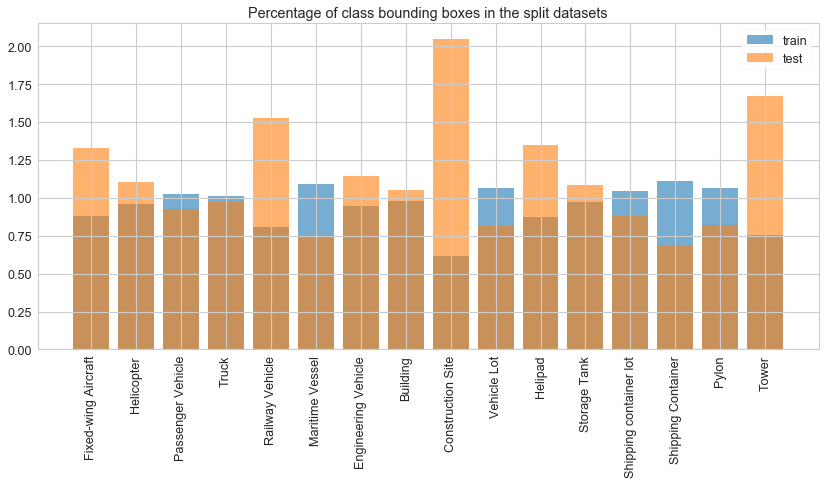

In [227]:
evaluate_split(df, X_train, X_test, col="parent_alt", evaluation_type = 'image_count')
evaluate_split(df, X_train, X_test, col="parent_alt", evaluation_type = 'full_count')

Images that would be retained for training and testing do not keep the original proportion. That is not so important in itself?

## Multi label split

**Multilabel split - data prep function**

In [228]:
from sklearn.preprocessing import OneHotEncoder
one_hot_classes = OneHotEncoder(sparse = False)
def data_prep_multilab(df, column):
    df_only_dummies = pd.DataFrame(one_hot_classes.fit_transform(df[[column]], ),
                              index = df.index, 
                              columns = one_hot_classes.get_feature_names(input_features=['c'])
                                  )
    df_w_dummies = pd.concat([df,df_only_dummies],
                            axis = 1)
    variables = ['image_id']
    variables.extend(one_hot_classes.get_feature_names(input_features=['c']))
    # data frame with unique row per image id and occurrences of each class    
    return df_w_dummies[variables].groupby('image_id').sum()

In [229]:
from skmultilearn.model_selection import IterativeStratification, iterative_train_test_split

### Multi label k fold test

In [233]:
df_img_class_count = data_prep_multilab(df, "parent_alt")
df_img_class_count.head()

,c_11,c_15,c_17,c_23,c_33,c_40,c_53,c_73,c_79,c_83,c_84,c_86,c_89,c_91,c_93,c_94
image_id,,,,,,,,,,,,,,,,
10.tif,0.0,0.0,2.0,1.0,0.0,0.0,0.0,53.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100.tif,0.0,0.0,62.0,7.0,0.0,0.0,0.0,66.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
102.tif,0.0,0.0,354.0,17.0,0.0,0.0,0.0,1594.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1036.tif,0.0,0.0,24.0,38.0,0.0,69.0,35.0,75.0,22.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0
1037.tif,0.0,0.0,268.0,159.0,0.0,0.0,20.0,85.0,41.0,18.0,0.0,24.0,0.0,0.0,0.0,0.0


In [236]:
df_img_class_count.isna().sum().sum()

0

In [239]:
sample_distribution_per_fold = [1-perc_data_to_use, perc_data_to_use]
k_fold = IterativeStratification(n_splits=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_img_class_count.index, y = df_img_class_count):
    img_train_idx = df_img_class_count.iloc[train,:].index
    img_test_idx = df_img_class_count.iloc[test,:].index

print(len(img_train_idx))
print(len(img_test_idx))

639
207



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.984 and the std = 0.06
For test split, mean of Freq of a class divided by the frequency of that class is 1.047 and the std = 0.18

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.019 and the std = 0.15
For test split, mean of Freq of a class divided by the frequency of that class is 0.952 and the std = 0.38


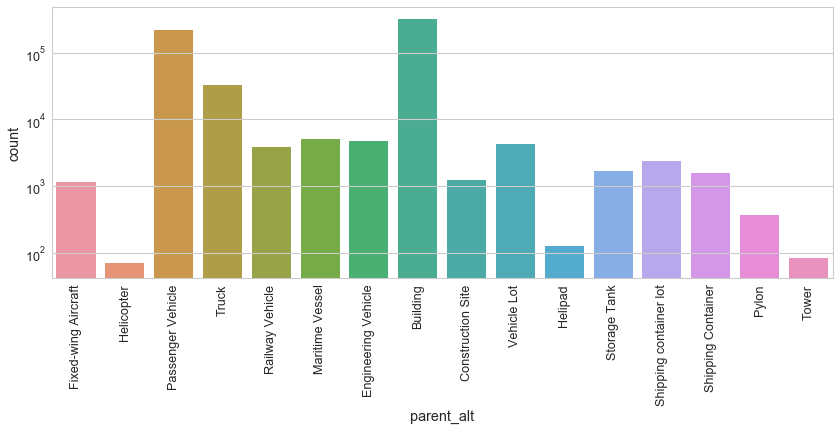

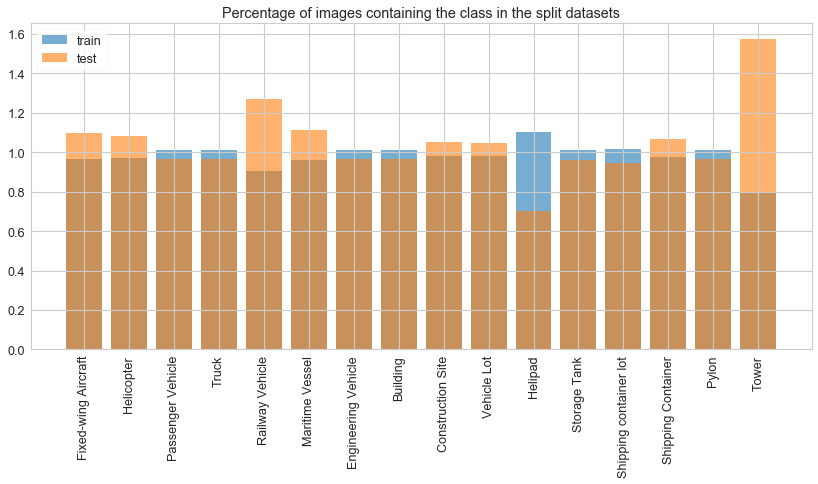

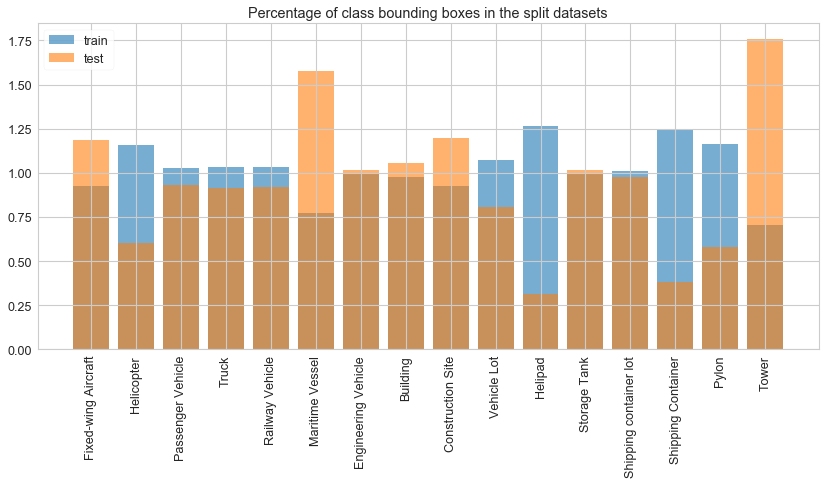

In [244]:
col = "parent_alt"
fig, ax = plt.subplots(figsize=(14,5))
ax.set_yscale("log")
sns.countplot(x=col, data = df)
ax.set_xticklabels([idx_to_name_map[col][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

# split evaluation
evaluate_split(df, img_train_idx, img_test_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df, img_train_idx, img_test_idx, col =col, evaluation_type = 'full_count')

### Test without considering the order

We transform this to another array indicating just if an image contains a class or not

In [245]:
df_img_class_present = df_img_class_count.copy()
# df_img_class_present.fillna(0, inplace=True)
df_img_class_present[df_img_class_present>0] = 1
df_img_class_present

,c_11,c_15,c_17,c_23,c_33,c_40,c_53,c_73,c_79,c_83,c_84,c_86,c_89,c_91,c_93,c_94
image_id,,,,,,,,,,,,,,,,
10.tif,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100.tif,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
102.tif,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1036.tif,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1037.tif,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97.tif,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
983.tif,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
986.tif,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [246]:
k_fold = IterativeStratification(n_splits=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_img_class_present.index, y = df_img_class_present):
    img_train_idx = df_img_class_present.iloc[train,:].index
    img_test_idx = df_img_class_present.iloc[test,:].index

print(len(img_train_idx))
print(len(img_test_idx))

639
207



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.984 and the std = 0.06
For test split, mean of Freq of a class divided by the frequency of that class is 1.047 and the std = 0.18

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.018 and the std = 0.15
For test split, mean of Freq of a class divided by the frequency of that class is 0.954 and the std = 0.38


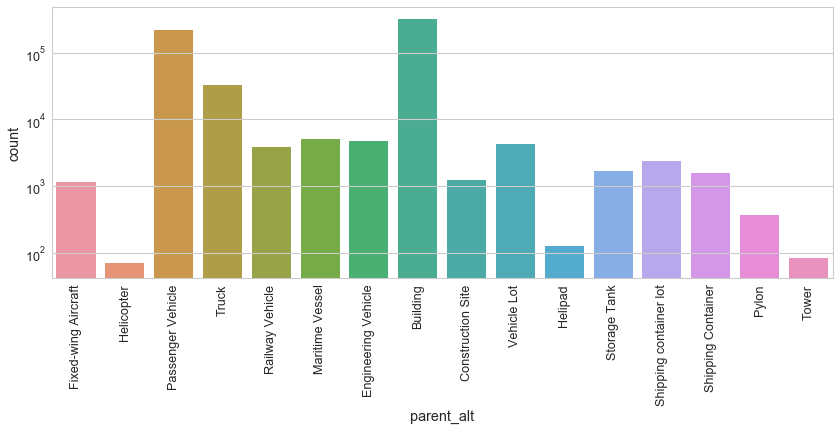

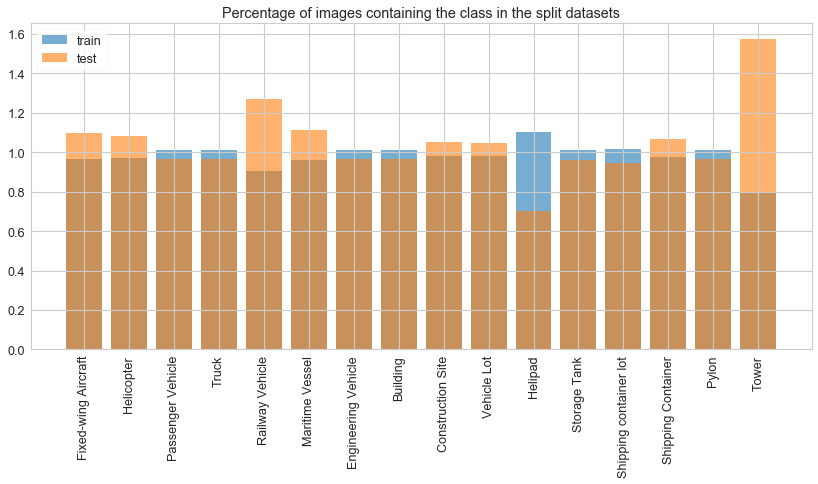

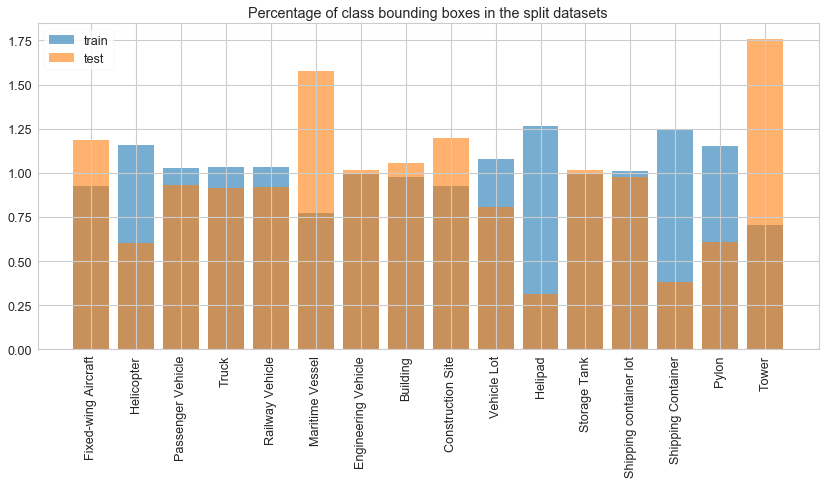

In [247]:
col = "parent_alt"
fig, ax = plt.subplots(figsize=(14,5))
ax.set_yscale("log")
sns.countplot(x=col, data = df)
ax.set_xticklabels([idx_to_name_map[col][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

# split evaluation
evaluate_split(df, img_train_idx, img_test_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df, img_train_idx, img_test_idx, col =col, evaluation_type = 'full_count')

### Multi label k fold test

In [249]:
k_fold = IterativeStratification(n_splits=2, order=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_img_class_count.index, y = df_img_class_count):
    img_train_idx = df_img_class_count.iloc[train,:].index
    img_test_idx = df_img_class_count.iloc[test,:].index

print(len(img_train_idx))
print(len(img_test_idx))

637
209



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.995 and the std = 0.03
For test split, mean of Freq of a class divided by the frequency of that class is 1.015 and the std = 0.10

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.057 and the std = 0.11
For test split, mean of Freq of a class divided by the frequency of that class is 0.880 and the std = 0.23


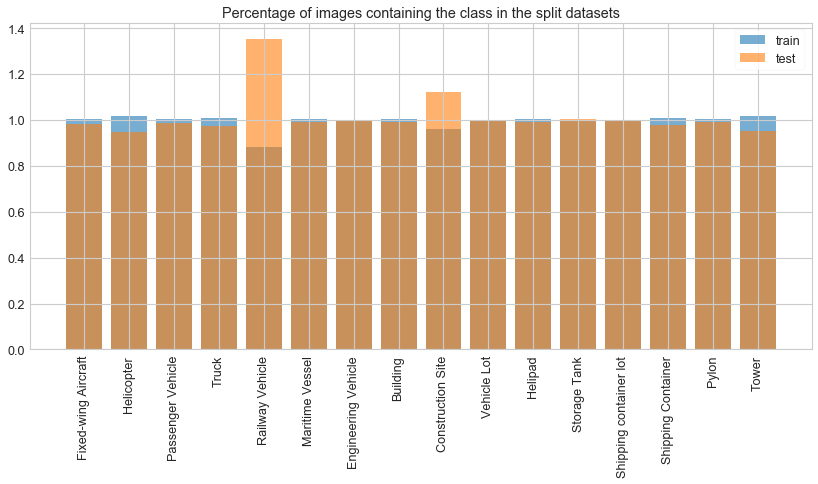

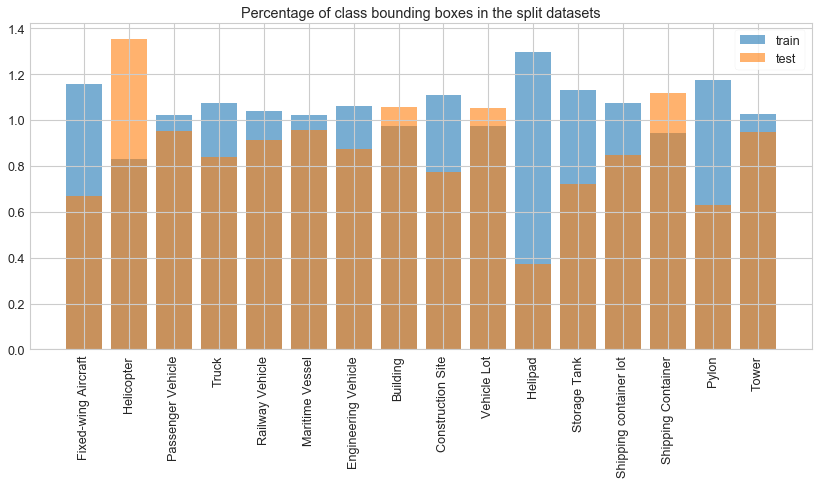

In [250]:
# split evaluation
evaluate_split(df, img_train_idx, img_test_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df, img_train_idx, img_test_idx, col =col, evaluation_type = 'full_count')

#### train_tst_split

In [253]:
X_train, y_train, X_test, y_test = iterative_train_test_split(
                                        X = df_img_class_count.index.values.reshape((-1,1)), 
                                        y = df_img_class_count.values, test_size = 0.25,
                                    )

print(len(X_train))
print(len(X_test))

635
211



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.974 and the std = 0.06
For test split, mean of Freq of a class divided by the frequency of that class is 1.074 and the std = 0.17

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.027 and the std = 0.12
For test split, mean of Freq of a class divided by the frequency of that class is 0.934 and the std = 0.30


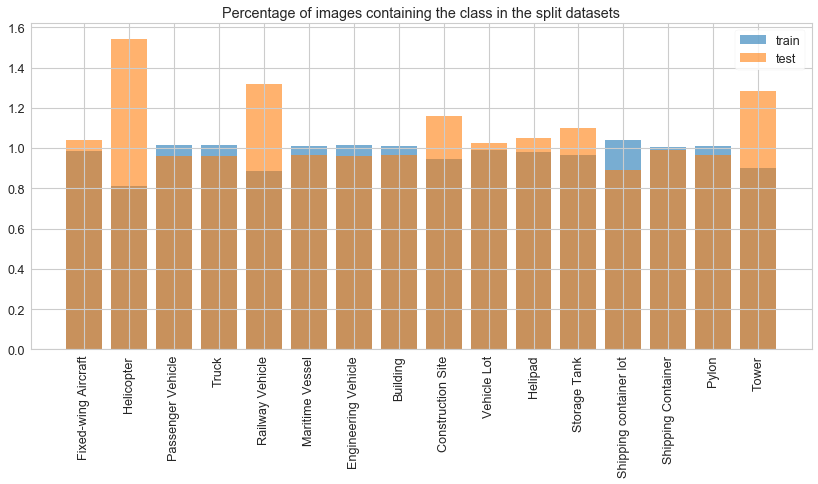

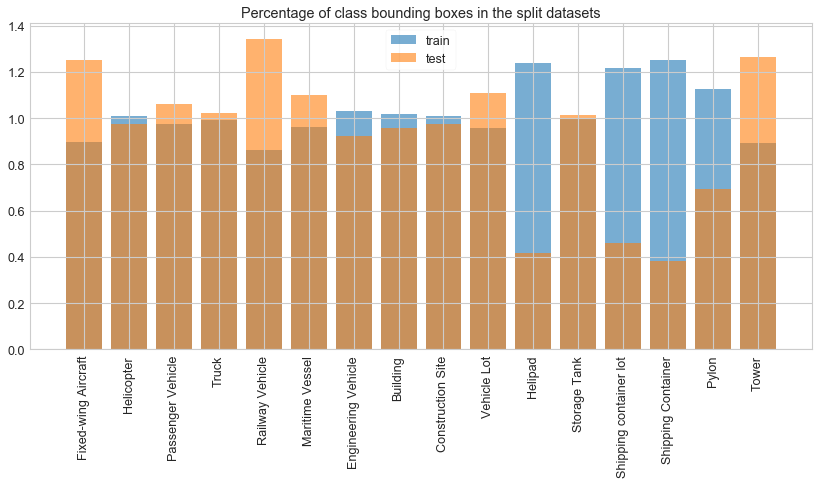

In [254]:
evaluate_split(df, X_train[:,0], X_test[:,0], col=col, evaluation_type = 'image_count')
evaluate_split(df, X_train[:,0], X_test[:,0], col=col, evaluation_type = 'full_count')

The test indexes will be the data used for this project, given the limited resources. We now have to split this data into train and test sets, (and validation)?

It seems that the best results were provided by the multi label k fold test of second order. Let's see if the seed does not change that

### Selected data

In [255]:
k_fold = IterativeStratification(n_splits=2, order=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_img_class_count.index, y = df_img_class_count):
    img_train_idx = df_img_class_count.iloc[train,:].index
    img_test_idx = df_img_class_count.iloc[test,:].index

print(len(img_train_idx))
print(len(img_test_idx))

631
215



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 0.991 and the std = 0.03
For test split, mean of Freq of a class divided by the frequency of that class is 1.026 and the std = 0.09

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.067 and the std = 0.11
For test split, mean of Freq of a class divided by the frequency of that class is 0.837 and the std = 0.27


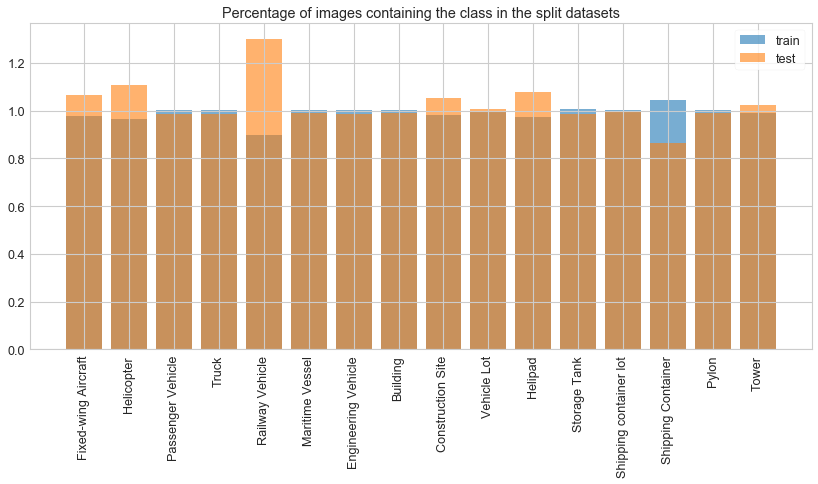

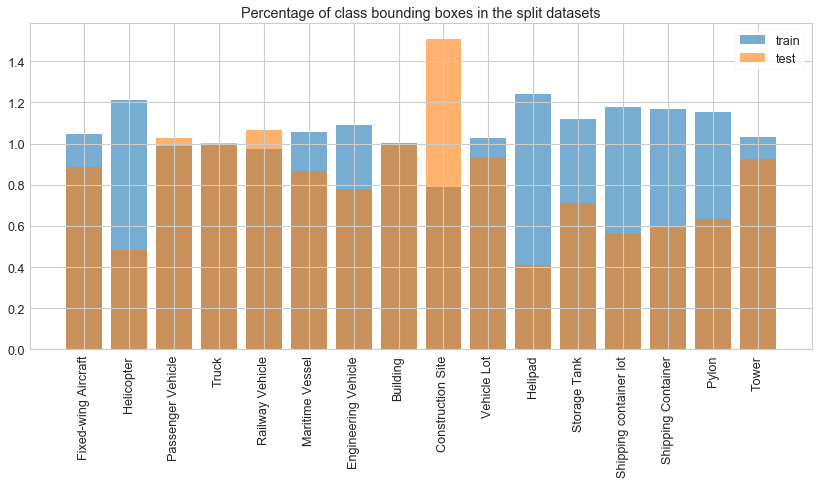

In [256]:
# split evaluation
evaluate_split(df, img_train_idx, img_test_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df, img_train_idx, img_test_idx, col =col, evaluation_type = 'full_count')

We now keep only those rows and split again, now to really obtain the test and train data

In [257]:
df_selected = obtain_df_from_image_id(df, img_test_idx)

In [259]:
len(df_selected)

175700

In [258]:
df_img_class_count = data_prep_multilab(df_selected, "parent_alt")
df_img_class_count.head()

,c_11,c_15,c_17,c_23,c_33,c_40,c_53,c_73,c_79,c_83,c_84,c_86,c_89,c_91,c_93,c_94
image_id,,,,,,,,,,,,,,,,
10.tif,0.0,0.0,2.0,1.0,0.0,0.0,0.0,53.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
100.tif,0.0,0.0,62.0,7.0,0.0,0.0,0.0,66.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1037.tif,0.0,0.0,268.0,159.0,0.0,0.0,20.0,85.0,41.0,18.0,0.0,24.0,0.0,0.0,0.0,0.0
1042.tif,0.0,0.0,24.0,77.0,0.0,0.0,74.0,82.0,173.0,20.0,0.0,5.0,0.0,27.0,0.0,0.0
1046.tif,0.0,0.0,7.0,7.0,0.0,0.0,14.0,10.0,31.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [260]:
df_img_class_count.isna().sum().sum()

0

In [261]:
perc_test = 0.5
sample_distribution_per_fold = [1-perc_test, perc_test]
k_fold = IterativeStratification(n_splits=2, order=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_img_class_count.index, y = df_img_class_count):
    img_train_idx = df_img_class_count.iloc[train,:].index
    img_test_idx = df_img_class_count.iloc[test,:].index

print(len(img_train_idx))
print(len(img_test_idx))

109
106



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.031 and the std = 0.13
For test split, mean of Freq of a class divided by the frequency of that class is 0.969 and the std = 0.13

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.100 and the std = 0.18
For test split, mean of Freq of a class divided by the frequency of that class is 0.890 and the std = 0.20


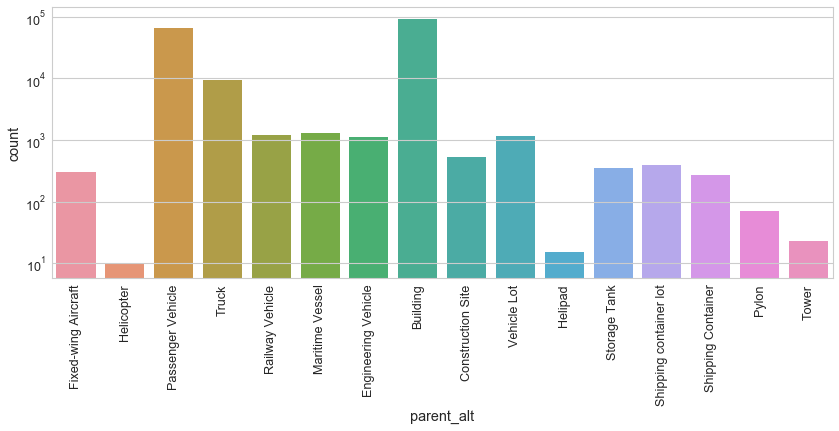

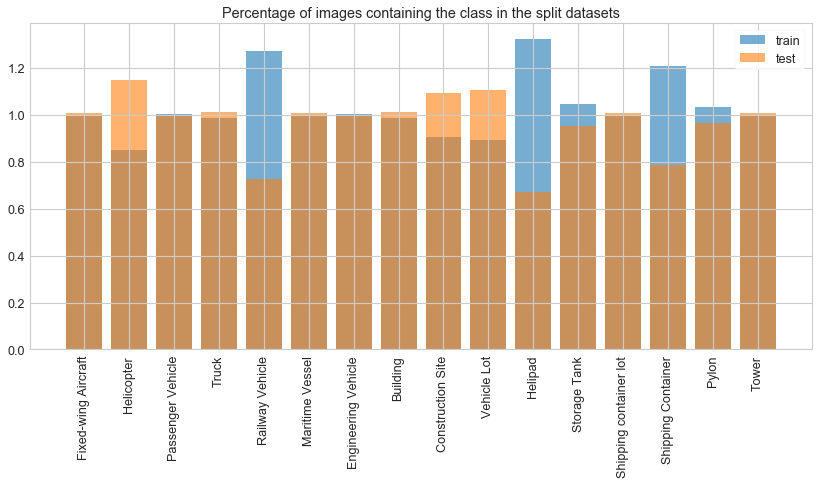

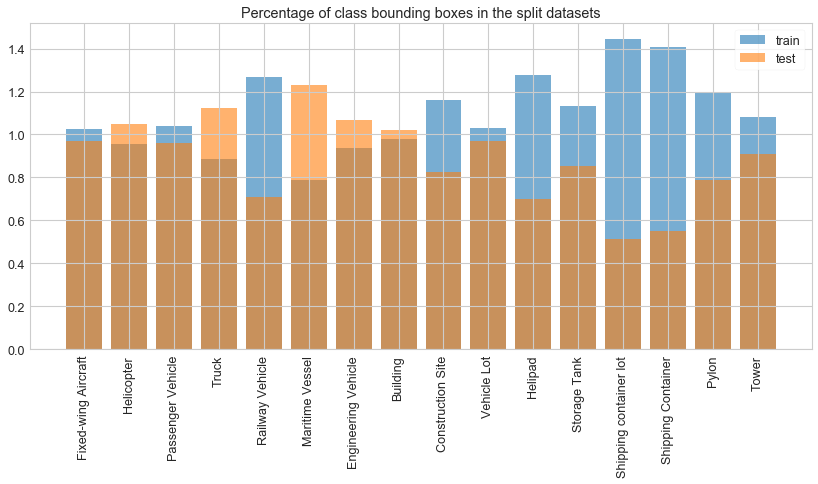

In [262]:
col = "parent_alt"
fig, ax = plt.subplots(figsize=(14,5))
ax.set_yscale("log")
sns.countplot(x=col, data = df_selected)
ax.set_xticklabels([idx_to_name_map[col][int(key.get_text())] for key in ax.get_xticklabels()], rotation = 90);

# split evaluation
evaluate_split(df_selected, img_train_idx, img_test_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df_selected, img_train_idx, img_test_idx, col =col, evaluation_type = 'full_count')

We take a 20% of test data to use it for evaluation

In [267]:
df_test_selected = df_img_class_count.loc[img_test_idx,:]

In [269]:
perc_eval = 0.2
sample_distribution_per_fold = [1-perc_eval, perc_eval]
k_fold = IterativeStratification(n_splits=2, order=2, sample_distribution_per_fold= sample_distribution_per_fold)
for train, test in k_fold.split(X=df_test_selected.index, y = df_test_selected):
    img_eval_idx = df_test_selected.iloc[test,:].index

print(len(img_test_idx))
print(len(img_eval_idx))

106
20



**************   image_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.000 and the std = 0.00
For test split, mean of Freq of a class divided by the frequency of that class is 0.910 and the std = 0.45

**************   full_count   **************
For train split, mean of Freq of a class divided by the frequency of that class is 1.000 and the std = 0.00
For test split, mean of Freq of a class divided by the frequency of that class is 1.068 and the std = 0.65


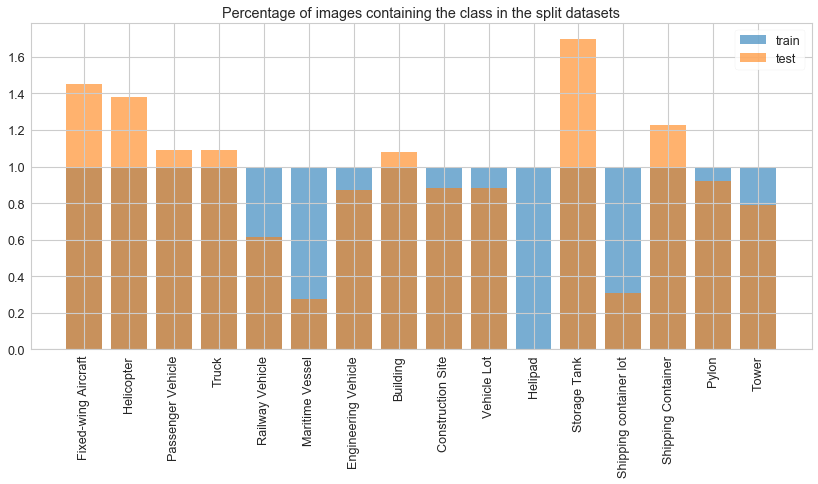

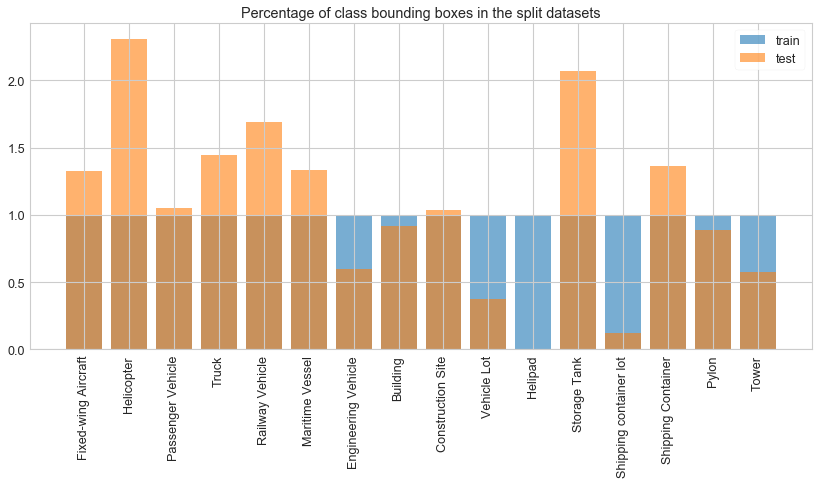

In [273]:
col = "parent_alt"

df_test = obtain_df_from_image_id(df,img_test_idx)

# split evaluation
evaluate_split(df_test, img_test_idx, img_eval_idx, col =col,  evaluation_type = 'image_count')
evaluate_split(df_test, img_test_idx, img_eval_idx, col =col, evaluation_type = 'full_count')

Unfortunately the evaluation data set is missing the helipad class, we will have to live with that. In any case we will get full evaluation of the performance of the model with the test dataset.

### Save the image indexes for use later

In [275]:
!pwd

/home/roberto/Documents/python/scripts/Udacity/ML_AWS/Capstone/satellites


In [276]:
os.path.join("xView","train.txt")

'xView/train.txt'

In [278]:
def save_img_idx(img_idx, filename, output_path="./"):
    image_list_array = np.array(img_idx)
    savepath = os.path.join(output_path,filename)
    np.savetxt(savepath,image_list_array, fmt = "%s")
    return f"Saved to {savepath}"

In [282]:
save_img_idx(img_train_idx, 'train.txt', output_path="xView/final_batch")

'Saved to xView/final_batch/train.txt'

In [285]:
save_img_idx(img_test_idx, 'test.txt', output_path="xView/final_batch")

'Saved to xView/final_batch/test.txt'

In [286]:
save_img_idx(img_eval_idx, 'eval.txt', output_path="xView/final_batch")

'Saved to xView/final_batch/eval.txt'

In [287]:
image_list_array = np.loadtxt(os.path.join("xView/final_batch","test.txt"), dtype = str)

In [288]:
print(image_list_array.shape)
print(image_list_array[:5])

(109,)
['100.tif' '1042.tif' '1046.tif' '1048.tif' '1051.tif']


## Store images in dedicated s3 bucket

In [289]:
old_s3_buck = "s3://xview-udacity/raw_images/all_img/"
new_s3_buck = "s3://xview-udacity/raw_images/final_batch/"

In [291]:
arr_list = list(img_train_idx) 
img = arr_list[0]

In [293]:
!aws s3 cp "{old_s3_buck}{img}" "{new_s3_buck}{dest_folder[i]}/"

copy: s3://xview-udacity/raw_images/all_img/100.tif to s3://xview-udacity/raw_images/final_batch/val/100.tif


In [295]:
img_arrays = [img_train_idx, img_test_idx, img_eval_idx]
dest_folder = ['train', 'test', 'val']
for i, arr in enumerate(img_arrays):
    arr_list = list(arr)    
    for img in  arr_list:
        !aws s3 cp "{old_s3_buck}{img}" "{new_s3_buck}{dest_folder[i]}/"

copy: s3://xview-udacity/raw_images/all_img/100.tif to s3://xview-udacity/raw_images/final_batch/train/100.tif
copy: s3://xview-udacity/raw_images/all_img/1042.tif to s3://xview-udacity/raw_images/final_batch/train/1042.tif
copy: s3://xview-udacity/raw_images/all_img/1046.tif to s3://xview-udacity/raw_images/final_batch/train/1046.tif
copy: s3://xview-udacity/raw_images/all_img/1048.tif to s3://xview-udacity/raw_images/final_batch/train/1048.tif
copy: s3://xview-udacity/raw_images/all_img/1051.tif to s3://xview-udacity/raw_images/final_batch/train/1051.tif
copy: s3://xview-udacity/raw_images/all_img/1061.tif to s3://xview-udacity/raw_images/final_batch/train/1061.tif
copy: s3://xview-udacity/raw_images/all_img/107.tif to s3://xview-udacity/raw_images/final_batch/train/107.tif
copy: s3://xview-udacity/raw_images/all_img/1076.tif to s3://xview-udacity/raw_images/final_batch/train/1076.tif
copy: s3://xview-udacity/raw_images/all_img/1080.tif to s3://xview-udacity/raw_images/final_batch/tr

copy: s3://xview-udacity/raw_images/all_img/1886.tif to s3://xview-udacity/raw_images/final_batch/train/1886.tif
copy: s3://xview-udacity/raw_images/all_img/1894.tif to s3://xview-udacity/raw_images/final_batch/train/1894.tif
copy: s3://xview-udacity/raw_images/all_img/1898.tif to s3://xview-udacity/raw_images/final_batch/train/1898.tif
copy: s3://xview-udacity/raw_images/all_img/1910.tif to s3://xview-udacity/raw_images/final_batch/train/1910.tif
copy: s3://xview-udacity/raw_images/all_img/1912.tif to s3://xview-udacity/raw_images/final_batch/train/1912.tif
copy: s3://xview-udacity/raw_images/all_img/1919.tif to s3://xview-udacity/raw_images/final_batch/train/1919.tif
copy: s3://xview-udacity/raw_images/all_img/1927.tif to s3://xview-udacity/raw_images/final_batch/train/1927.tif
copy: s3://xview-udacity/raw_images/all_img/1938.tif to s3://xview-udacity/raw_images/final_batch/train/1938.tif
copy: s3://xview-udacity/raw_images/all_img/1980.tif to s3://xview-udacity/raw_images/final_batc

copy: s3://xview-udacity/raw_images/all_img/1087.tif to s3://xview-udacity/raw_images/final_batch/val/1087.tif
copy: s3://xview-udacity/raw_images/all_img/1094.tif to s3://xview-udacity/raw_images/final_batch/val/1094.tif
copy: s3://xview-udacity/raw_images/all_img/1118.tif to s3://xview-udacity/raw_images/final_batch/val/1118.tif
copy: s3://xview-udacity/raw_images/all_img/1133.tif to s3://xview-udacity/raw_images/final_batch/val/1133.tif
copy: s3://xview-udacity/raw_images/all_img/1141.tif to s3://xview-udacity/raw_images/final_batch/val/1141.tif
copy: s3://xview-udacity/raw_images/all_img/118.tif to s3://xview-udacity/raw_images/final_batch/val/118.tif
copy: s3://xview-udacity/raw_images/all_img/1196.tif to s3://xview-udacity/raw_images/final_batch/val/1196.tif
copy: s3://xview-udacity/raw_images/all_img/1216.tif to s3://xview-udacity/raw_images/final_batch/val/1216.tif
copy: s3://xview-udacity/raw_images/all_img/1256.tif to s3://xview-udacity/raw_images/final_batch/val/1256.tif
cop

## References

Darius Lam, Richard Kuzma, Kevin McGee, Samuel Dooley, Michael Laielli, Matthew Klaric, Yaroslav Bulatov, Brendan McCord. xView: Objects in Context in Overhead Imagery, 2018. https://arxiv.org/abs/1802.07856v1